In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import gaussian_kde

import plotly
import plotly.graph_objs as go
from plotly import tools
import plotly.figure_factory as ff

##############  OFFLINE  ##############
plotly.offline.init_notebook_mode(connected=True)
#to plot offline: ##plotly.offline.iplot##

##############  ONLINE  ##############
#plotly.tools.set_credentials_file(username='arnaurovira23', api_key='7y46ugRJ8Rl6XCkCwBGM')
#to plot online: ##py.iplot##
import plotly.plotly as py


# LOAD DATA

###### train dataset

In [2]:
#Load train dataset
df_train = pd.read_csv('data/train.csv').sample(frac=1, random_state = 20)
df_train.head()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
9129,9130,2843,53,23,234,29,1146,226,184,81,...,0,1,0,0,0,0,0,0,0,2
2372,2373,2838,262,13,60,15,1879,189,246,196,...,0,0,0,0,0,0,0,0,0,5
3365,3366,2360,251,25,335,66,1153,158,248,222,...,0,0,0,0,0,0,0,0,0,4
4720,4721,2247,106,16,0,0,849,246,218,96,...,0,0,0,0,0,0,0,0,0,4
7458,7459,2747,45,26,175,98,1328,217,175,79,...,0,0,0,0,0,0,0,0,0,5


In [3]:
df_train.describe()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
count,15120.00000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,...,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000
mean,7560.50000,2749.322553,156.676653,16.501587,227.195701,51.076521,1714.023214,212.704299,218.965608,135.091997,...,0.045635,0.040741,0.001455,0.006746,0.000661,0.002249,0.048148,0.043452,0.030357,4.000000
std,4364.91237,417.678187,110.085801,8.453927,210.075296,61.239406,1325.066358,30.561287,22.801966,45.895189,...,0.208699,0.197696,0.038118,0.081859,0.025710,0.047368,0.214086,0.203880,0.171574,2.000066
min,1.00000,1863.000000,0.000000,0.000000,0.000000,-146.000000,0.000000,0.000000,99.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,3780.75000,2376.000000,65.000000,10.000000,67.000000,5.000000,764.000000,196.000000,207.000000,106.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
50%,7560.50000,2752.000000,126.000000,15.000000,180.000000,32.000000,1316.000000,220.000000,223.000000,138.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000
75%,11340.25000,3104.000000,261.000000,22.000000,330.000000,79.000000,2270.000000,235.000000,235.000000,167.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000
max,15120.00000,3849.000000,360.000000,52.000000,1343.000000,554.000000,6890.000000,254.000000,254.000000,248.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000


In [4]:
#Shape of train dataset
num_train = df_train.shape[0]
print(num_train)

15120


In [5]:
features_all = df_train.drop(columns='Id').columns.tolist()
print(features_all)

['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points', 'Wilderness_Area1', 'Wilderness_Area2', 'Wilderness_Area3', 'Wilderness_Area4', 'Soil_Type1', 'Soil_Type2', 'Soil_Type3', 'Soil_Type4', 'Soil_Type5', 'Soil_Type6', 'Soil_Type7', 'Soil_Type8', 'Soil_Type9', 'Soil_Type10', 'Soil_Type11', 'Soil_Type12', 'Soil_Type13', 'Soil_Type14', 'Soil_Type15', 'Soil_Type16', 'Soil_Type17', 'Soil_Type18', 'Soil_Type19', 'Soil_Type20', 'Soil_Type21', 'Soil_Type22', 'Soil_Type23', 'Soil_Type24', 'Soil_Type25', 'Soil_Type26', 'Soil_Type27', 'Soil_Type28', 'Soil_Type29', 'Soil_Type30', 'Soil_Type31', 'Soil_Type32', 'Soil_Type33', 'Soil_Type34', 'Soil_Type35', 'Soil_Type36', 'Soil_Type37', 'Soil_Type38', 'Soil_Type39', 'Soil_Type40', 'Cover_Type']


In [6]:
feat_soils = [feat for feat in features_all if 'Soil' in feat]
feat_wild = [feat for feat in features_all if 'Wilderness' in feat]
feat_num = [feat for feat in features_all if ('Wilderness' not in feat) & ('Soil' not in feat) & ('Cover' not in feat)]

In [7]:
df_train.isnull().sum().sum()
print(f"How many NaN values are in df_train dataset? {df_train.isnull().sum().sum()}")

How many NaN values are in df_train dataset? 0


In [8]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15120 entries, 9129 to 10714
Data columns (total 56 columns):
Id                                    15120 non-null int64
Elevation                             15120 non-null int64
Aspect                                15120 non-null int64
Slope                                 15120 non-null int64
Horizontal_Distance_To_Hydrology      15120 non-null int64
Vertical_Distance_To_Hydrology        15120 non-null int64
Horizontal_Distance_To_Roadways       15120 non-null int64
Hillshade_9am                         15120 non-null int64
Hillshade_Noon                        15120 non-null int64
Hillshade_3pm                         15120 non-null int64
Horizontal_Distance_To_Fire_Points    15120 non-null int64
Wilderness_Area1                      15120 non-null int64
Wilderness_Area2                      15120 non-null int64
Wilderness_Area3                      15120 non-null int64
Wilderness_Area4                      15120 non-null int64
Soi

Since the soil and wilderness type features are dummy categorical variables and the cover type are labels, we use uint8

In [9]:
df_train[feat_wild]=df_train[feat_wild].astype('uint8')
df_train[feat_soils]=df_train[feat_soils].astype('uint8')
df_train['Cover_Type']=df_train['Cover_Type'].astype('uint8')

In [10]:
df_train.dtypes

Id                                    int64
Elevation                             int64
Aspect                                int64
Slope                                 int64
Horizontal_Distance_To_Hydrology      int64
Vertical_Distance_To_Hydrology        int64
Horizontal_Distance_To_Roadways       int64
Hillshade_9am                         int64
Hillshade_Noon                        int64
Hillshade_3pm                         int64
Horizontal_Distance_To_Fire_Points    int64
Wilderness_Area1                      uint8
Wilderness_Area2                      uint8
Wilderness_Area3                      uint8
Wilderness_Area4                      uint8
Soil_Type1                            uint8
Soil_Type2                            uint8
Soil_Type3                            uint8
Soil_Type4                            uint8
Soil_Type5                            uint8
Soil_Type6                            uint8
Soil_Type7                            uint8
Soil_Type8                      

###### test dataset

In [11]:
#Load test dataset
df_test = pd.read_csv('data/test.csv').sample(frac=1, random_state = 10)
df_test.head()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40
34963,50084,2700,45,11,175,41,1075,223,216,126,...,0,0,0,0,0,0,0,0,0,0
205423,220544,2836,70,26,192,72,1273,237,180,59,...,0,0,1,0,0,0,0,0,0,0
460666,475787,3202,315,9,42,7,4227,195,233,177,...,0,0,0,0,0,0,0,1,0,0
273455,288576,2381,281,19,228,54,201,166,239,211,...,0,0,0,0,0,0,0,0,0,0
237860,252981,2291,315,29,85,23,190,130,202,205,...,0,0,0,0,0,0,0,0,0,0


In [12]:
df_test.describe()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40
count,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,...,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000
mean,298066.500000,2964.977407,155.629558,14.039635,270.556622,46.294408,2367.143116,212.131133,223.435026,142.726951,...,0.044768,0.091588,0.078704,0.002808,0.003161,0.000193,0.000467,0.026233,0.023236,0.014651
std,163359.093603,273.157030,111.962120,7.450155,212.500153,58.209469,1561.482002,26.661063,19.668053,38.030094,...,0.206795,0.288444,0.269277,0.052916,0.056137,0.013877,0.021594,0.159827,0.150652,0.120152
min,15121.000000,1859.000000,0.000000,0.000000,0.000000,-173.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,156593.750000,2818.000000,58.000000,9.000000,108.000000,7.000000,1116.000000,198.000000,213.000000,119.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,298066.500000,2999.000000,127.000000,13.000000,228.000000,29.000000,2018.000000,218.000000,226.000000,143.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,439539.250000,3164.000000,260.000000,18.000000,390.000000,69.000000,3349.000000,231.000000,237.000000,168.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,581012.000000,3858.000000,360.000000,66.000000,1397.000000,601.000000,7117.000000,254.000000,254.000000,254.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [13]:
df_test.isnull().sum().sum()
print(f"How many NaN values are in df_train dataset? {df_test.isnull().sum().sum()}")

How many NaN values are in df_train dataset? 0


In [14]:
df_test.dtypes

Id                                    int64
Elevation                             int64
Aspect                                int64
Slope                                 int64
Horizontal_Distance_To_Hydrology      int64
Vertical_Distance_To_Hydrology        int64
Horizontal_Distance_To_Roadways       int64
Hillshade_9am                         int64
Hillshade_Noon                        int64
Hillshade_3pm                         int64
Horizontal_Distance_To_Fire_Points    int64
Wilderness_Area1                      int64
Wilderness_Area2                      int64
Wilderness_Area3                      int64
Wilderness_Area4                      int64
Soil_Type1                            int64
Soil_Type2                            int64
Soil_Type3                            int64
Soil_Type4                            int64
Soil_Type5                            int64
Soil_Type6                            int64
Soil_Type7                            int64
Soil_Type8                      

In [15]:
#Shape of test dataset
num_test = df_test.shape[0]
print(num_test)

565892


In [16]:
df_test[feat_wild]=df_test[feat_wild].astype('uint8')
df_test[feat_soils]=df_test[feat_soils].astype('uint8')

# EXPLORATORY DATA ANALYSIS
#### Analyze class balance

In [17]:
#count number of Cover_Type == TARGET on train dataset
df_train['Cover_Type'].value_counts()
covertypes = np.sort(df_train['Cover_Type'].unique())
num_ct = len(covertypes)


Each target has 2160 observations

### Visualize histogram of feature hued by cover type

In [18]:
feature = 'Elevation'
trace = []
group_labels = []

for i in np.sort(df_train['Cover_Type'].unique())[::-1]:
    trace.append(df_train[df_train['Cover_Type']==i][feature])
    group_labels.append(f"Cover_Type{int(i)}")

fig = ff.create_distplot(trace, group_labels, show_rug = True, show_hist=False)
fig['layout'].update(title=f"Hist and Dist of {feature}")

# Plot!
plotly.offline.iplot(fig, filename='Distplot with Multiple Datasets')

### Visualize histogram of all features in a given cover type

In [19]:
trace = []
name = []

features = df_train.columns.tolist()[1:11]
#number of desired cover type or -1 for all cover types
cover_type = -1
for i, feat in enumerate(features):
    if cover_type > 0:
        trace.append(go.Histogram(x = df_train.loc[df_train['Cover_Type']==cover_type,feat],nbinsx=30,opacity = 0.75))
    else:
        trace.append(go.Histogram(x = df_train[feat],nbinsx=30,opacity = 0.75))        
        
    name.append(feat)

    
fig = tools.make_subplots(rows=2, cols=5,subplot_titles = name, vertical_spacing=.2, horizontal_spacing=.05 )

[(lambda title: title['font'].update(size=15))(title) for title in fig['layout'].annotations]

if cover_type > 0:
    fig['layout'].update(showlegend=False, title=f'Histograms of all features for Cover_Type{cover_type}')
else:
    fig['layout'].update(showlegend=False, title=f'Histograms of all features for all cover types')
    



m = 0
#row
for x in range(1,3):
    #column
    for n in range(1,6):
        fig.append_trace(trace[m], x, n)
        m = m + 1


plotly.offline.iplot(fig, filename='custom binning')

This is the format of your plot grid:
[ (1,1) x1,y1 ]    [ (1,2) x2,y2 ]    [ (1,3) x3,y3 ]    [ (1,4) x4,y4 ]    [ (1,5) x5,y5 ]  
[ (2,1) x6,y6 ]    [ (2,2) x7,y7 ]    [ (2,3) x8,y8 ]    [ (2,4) x9,y9 ]    [ (2,5) x10,y10 ]



In [20]:
def compare_dist(ax, feature, i=0):
    for ct in covertypes:
        sns.kdeplot(df_train[df_train['Cover_Type']==ct][feature], label = f"Cover_Type{ct}", ax=ax)

def numeric_tile(plot_func):
    fig, axs = plt.subplots(2, 5, figsize=(45, 25))
    axs = axs.flatten()
    
    for i, (ax, col) in enumerate(zip(axs, features)):
        plot_func(ax, col, i)
        ax.set_title(col)
        sns.set(font_scale=2) 
        sns.set_style("ticks")
        ax.legend(frameon=False)
    plt.tight_layout()

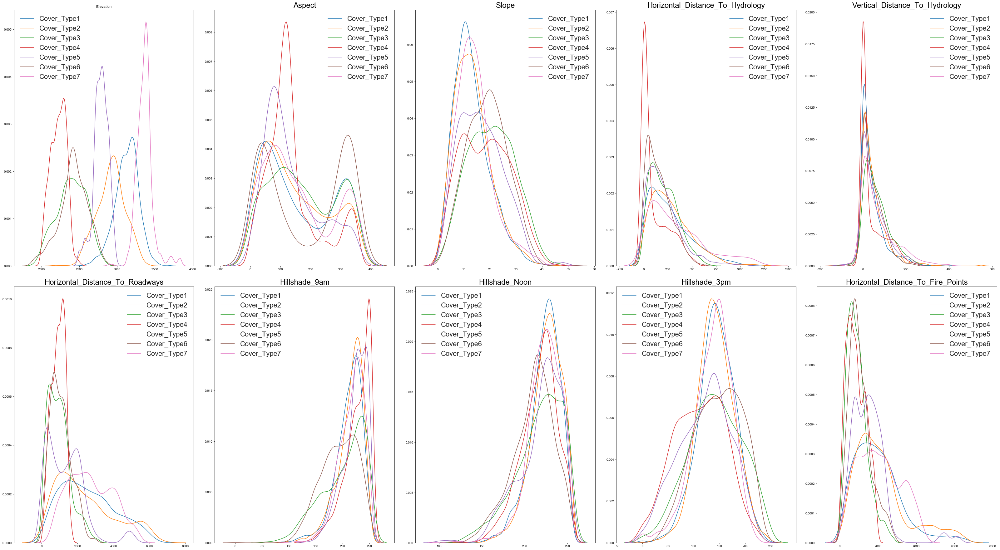

In [21]:
numeric_tile(compare_dist)

### Compare train and test features

In [22]:
#histograms of train vs test

def compare_dist(ax, feature, i=0):
    sns.kdeplot(df_train[feature], label="train", ax=ax)
    sns.kdeplot(df_test[feature], label="test", ax=ax)


def numeric_tile(plot_func):
    fig, axs = plt.subplots(2, 5, figsize=(24, 10))
    axs = axs.flatten()
    
    for i, (ax, col) in enumerate(zip(axs, features)):
        plot_func(ax, col, i)
        ax.set_title(col)
        sns.set(font_scale=1.3) 
        sns.set_style("ticks")
        ax.legend(frameon=False)
    plt.tight_layout()

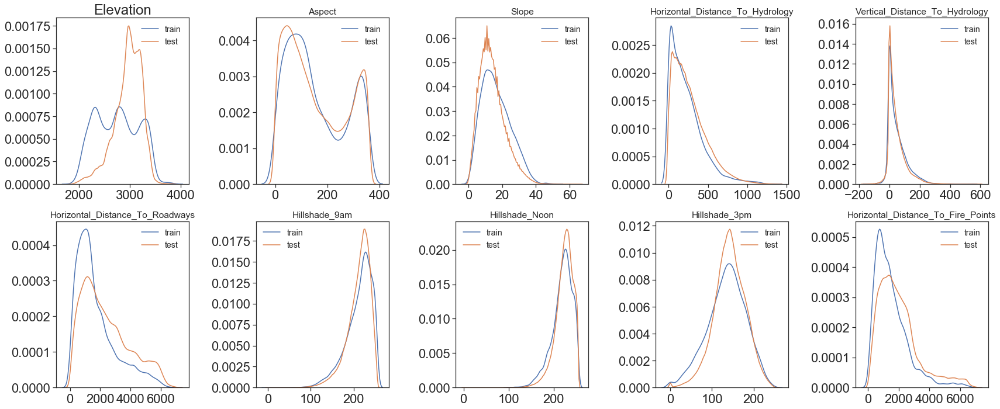

In [23]:
numeric_tile(compare_dist)

Elevation is quite different between train and test set

## Analysis of outliers Train dataset
### Number of outliers based on IQR
#### Outliers broken down by cover type

In [24]:
feature = 'Elevation'
trace = []
group_labels = []

for i in covertypes:
    trace.append(go.Box(y = df_train[df_train['Cover_Type']==i][feature], name = f'Cover_Type{int(i)}'))

layout = go.Layout(showlegend=False, xaxis = dict(tickfont=dict(size=12)), title = f"Box plot of {feature}")

fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig, filename="Box Plot Styling Outliers")

In [25]:
indexes = [f'Cover_Type{x}' for x in covertypes]

dic_ = {}

#definir en numero de features a mostrar
feature=['Elevation']

for feat in feature:
       
    out = []
    out_pct = []
    for ct in covertypes:
    
        df_ct = df_train.loc[df_train['Cover_Type']==ct]
        
    
        Q1 = df_ct[feat].quantile(0.25)
        Q3 = df_ct[feat].quantile(0.75)
        IQR = Q3 - Q1
    
        out_tm = ((df_ct[feat] < (Q1 - 1.5 * IQR)) | (df_ct[feat] > (Q3 + 1.5 * IQR)))
        out.append(out_tm.sum())
        out_pct.append(100*out_tm.sum()/df_ct.shape[0])
    dic_[f'{feat}_IQR_outliers'] = out
    dic_[f'{feat}_%_IQR_outliers'] = out_pct  


df_outliers_iqr = pd.DataFrame(dic_,index=indexes)
df_outliers_iqr

,Elevation_IQR_outliers,Elevation_%_IQR_outliers
Cover_Type1,43,1.990741
Cover_Type2,9,0.416667
Cover_Type3,0,0.000000
Cover_Type4,0,0.000000
Cover_Type5,45,2.083333
Cover_Type6,41,1.898148
Cover_Type7,88,4.074074


#### Outliers for all features

In [26]:
Q1 = df_train[features].quantile(0.25)
Q3 = df_train[features].quantile(0.75)
IQR = Q3 - Q1

out_tm = ((df_train[features] < (Q1 - 1.5 * IQR)) | (df_train[features] > (Q3 + 1.5 * IQR)))
outliers_iqr = pd.DataFrame(data={'outliers_IQR_count':out_tm.sum(),
                                  'outliers_IQR_%':100*out_tm.sum()/num_train})

outliers_iqr = outliers_iqr.sort_values(by='outliers_IQR_count',ascending=False)


Horizontal and Vertical distances features are the ones with more outliers based on IQR

In [27]:
trace = []
group_labels = []

trace = [go.Bar(y = outliers_iqr.index, x = outliers_iqr['outliers_IQR_count'],
               marker=dict(color='maroon',line=dict(color='black',width=1)),orientation ='h')]
    

layout = go.Layout(autosize=True,barmode='group',xaxis = dict(title = 'Total number of outliers',
                                                              tickfont=dict(size=10)), 
                   yaxis = dict(automargin=True,autorange = "reversed"),
                   title = 'Total Outliers IQR per feature in Train')
fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig)

###### Total outliers by Cover_Type

In [28]:
indexes = [f'Cover_Type{x}' for x in covertypes]


dic_ = {}

#definir en numero de features a mostrar
feat_num = [feat for feat in features_all if ('Wilderness' not in feat) & ('Soil' not in feat) & ('Cover' not in feat)]

for feat in feat_num:
       
    out = []
    out_pct = []
    for ct in covertypes:
    
        df_ct = df_train.loc[df_train['Cover_Type']==ct]
        
    
        Q1 = df_ct[feat].quantile(0.25)
        Q3 = df_ct[feat].quantile(0.75)
        IQR = Q3 - Q1
    
        out_tm = ((df_ct[feat] < (Q1 - 1.5 * IQR)) | (df_ct[feat] > (Q3 + 1.5 * IQR)))
        out.append(out_tm.sum())
        
    dic_[f'{feat}_IQR_outliers'] = out  


df_outliers_iqr_total = pd.DataFrame(dic_,index=indexes)

In [29]:
df_outliers_ct_iqr = pd.DataFrame(df_outliers_iqr_total.sum(axis = 1)).\
                     rename(columns={0:'Outliers_IQR_Total'}).sort_values(by='Outliers_IQR_Total', 
                                                                        ascending=False)
df_outliers_ct_iqr['%_IQR'] = 100*df_outliers_ct_iqr['Outliers_IQR_Total']/df_outliers_ct_iqr['Outliers_IQR_Total'].sum()


In [30]:
trace = []
group_labels = []

trace = [go.Bar(x = df_outliers_ct_iqr.index, y = df_outliers_ct_iqr['Outliers_IQR_Total'],
               marker=dict(color='maroon',line=dict(color='black',width=1)))]
    

layout = go.Layout(width=700,barmode='group',xaxis = dict(tickfont=dict(size=10)),
                   title = 'Total Outliers IQR per Cover_Type in Train',
                   yaxis = dict(title = 'Total number of outliers'))
fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig)

### Number of outliers based on SD

#### Outliers broken down by cover type

In [31]:
dic_ = {}

#definir en numero de features a mostrar
feature=['Elevation']
#definir cutoff:
cutoff = 4

for feat in feature:
    
    out = []
    out_pct = []
    
    for ct in covertypes:
    
        df_ct = df_train.loc[df_train['Cover_Type']==ct]
        
        ct_mean, ct_std = np.mean(df_ct[feat]), np.std(df_ct[feat])
        cut_off = ct_std * cutoff
        lower, upper = ct_mean - cut_off, ct_mean + cut_off
    
        out_tm = ((df_ct[feat] < lower) | (df_ct[feat] > upper))
        out.append(out_tm.sum())
        out_pct.append(100*out_tm.sum()/df_ct.shape[0])
    dic_[f'{feat}_SD_outliers'] = out
    dic_[f'{feat}_%_SD_outliers'] = out_pct  

df_outliers_sd = pd.DataFrame(dic_,index=indexes)
df_outliers_sd

,Elevation_SD_outliers,Elevation_%_SD_outliers
Cover_Type1,0,0.000000
Cover_Type2,1,0.046296
Cover_Type3,0,0.000000
Cover_Type4,0,0.000000
Cover_Type5,0,0.000000
Cover_Type6,0,0.000000
Cover_Type7,27,1.250000


#### Outliers for all features

In [32]:
cutoff = 4

ct_mean, ct_std = np.mean(df_train[features]), np.std(df_train[features])
cut_off = ct_std * cutoff
lower, upper = ct_mean - cut_off, ct_mean + cut_off
out_tm = ((df_train[features] < lower) | (df_train[features] > upper))
outliers_sd = pd.DataFrame(data = {'outliers_SD_count':out_tm.sum(),\
                                  'outliers_SD_%':100*out_tm.sum()/df_train.shape[0]})
outliers_sd = outliers_sd.sort_values(by='outliers_SD_count',ascending=False)

In [33]:
trace = []
group_labels = []

trace = [go.Bar(y = outliers_sd.index, x = outliers_sd['outliers_SD_count'],
               marker=dict(color='maroon',line=dict(color='maroon',width=1)),orientation ='h')]
    

layout = go.Layout(autosize=True,barmode='group',xaxis = dict(title = 'Total number of outliers',tickfont=dict(size=10)), \
                   yaxis = dict(automargin=True,autorange = "reversed"),\
                   title = 'Total Outliers SD per feature in Train')
fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig)

###### Total outliers by Cover_Type

In [34]:
indexes = [f'Cover_Type{x}' for x in covertypes]


dic_ = {}

#definir en numero de features a mostrar
feat_num = [feat for feat in features_all if ('Wilderness' not in feat) & ('Soil' not in feat) & ('Cover' not in feat)]

for feat in feat_num:
       
    out = []
    out_pct = []
    for ct in covertypes:
    
        df_ct = df_train.loc[df_train['Cover_Type']==ct]
        
    
        ct_mean, ct_std = np.mean(df_ct[feat]), np.std(df_ct[feat])
        cut_off = ct_std * cutoff
        lower, upper = ct_mean - cut_off, ct_mean + cut_off
    
        out_tm = ((df_ct[feat] < lower) | (df_ct[feat] > upper))
        out.append(out_tm.sum())
        #out_pct.append(100*out_tm.sum()/df_ct.shape[0])
    dic_[f'{feat}_SD_outliers'] = out
    #dic_[f'{feat}_%_outliers'] = out_pct  


df_outliers_total_sd = pd.DataFrame(dic_,index=indexes)


In [35]:
df_outliers_ct_sd = pd.DataFrame(df_outliers_total_sd.sum(axis = 1)).\
                     rename(columns={0:'Outliers_SD_Total'}).sort_values(by='Outliers_SD_Total', ascending=False)
df_outliers_ct_sd['%_SD'] = 100*df_outliers_ct_sd['Outliers_SD_Total']/df_outliers_ct_sd['Outliers_SD_Total'].sum()


In [36]:
trace = []
group_labels = []

trace = [go.Bar(x = df_outliers_ct_sd.index, y = df_outliers_ct_sd['Outliers_SD_Total'],
               marker=dict(color='maroon',line=dict(color='maroon',width=1)))]
    

layout = go.Layout(width=700,barmode='group',xaxis = dict(tickfont=dict(size=10)), title = 'Total Outliers SD per Cover_Type in Train',\
                  yaxis = dict(title = 'Total number of outliers'))
fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig)

### Compare between IQR and SD outliers by Cover_Type

In [37]:
diff_otl = df_outliers_ct_sd.merge(df_outliers_ct_iqr, left_index = True, right_index=True)
diff_otl['diff_%'] = abs(diff_otl['%_IQR'] - diff_otl['%_SD'])
diff_otl = diff_otl.sort_values('diff_%',ascending=False)
diff_otl

,Outliers_SD_Total,%_SD,Outliers_IQR_Total,%_IQR,diff_%
Cover_Type5,74,38.341969,427,15.891329,22.450640
Cover_Type4,1,0.518135,452,16.821734,16.303600
Cover_Type7,54,27.979275,408,15.184220,12.795054
Cover_Type1,20,10.362694,488,18.161518,7.798824
Cover_Type3,0,0.000000,197,7.331597,7.331597
Cover_Type6,6,3.108808,198,7.368813,4.260005
Cover_Type2,38,19.689119,517,19.240789,0.448330


In [38]:
trace0 = go.Scatter(x=diff_otl.index,y=diff_otl['%_SD'], name = 'outliers_SD',
                    line=dict(color='orange'))
trace1 = go.Scatter(x=diff_otl.index,y=diff_otl['%_IQR'], name = 'outliers_IQR',
                    line=dict(color='blue'))
fig = go.Figure(data=[trace1,trace0])
fig['layout'].update(title='Compare between IQR and SD outliers by Cover_Type Train',yaxis = dict(title = '% outliers'))
plotly.offline.iplot(fig, filename='basic-line')


### Compare between IQR and SD outliers by features

In [39]:
diff_otl_feat = outliers_iqr.merge(outliers_sd, right_index = True, left_index = True)
diff_otl_feat['diff_%'] = abs(diff_otl_feat['outliers_IQR_%'] - diff_otl_feat['outliers_SD_%'])
diff_otl_feat = diff_otl_feat.sort_values('diff_%', ascending = False)
diff_otl_feat

,outliers_IQR_count,outliers_IQR_%,outliers_SD_count,outliers_SD_%,diff_%
Horizontal_Distance_To_Roadways,830,5.489418,0,0.000000,5.489418
Horizontal_Distance_To_Fire_Points,645,4.265873,114,0.753968,3.511905
Vertical_Distance_To_Hydrology,586,3.875661,55,0.363757,3.511905
Horizontal_Distance_To_Hydrology,512,3.386243,85,0.562169,2.824074
Hillshade_9am,408,2.698413,22,0.145503,2.552910
Hillshade_Noon,393,2.599206,28,0.185185,2.414021
Hillshade_3pm,124,0.820106,0,0.000000,0.820106
Slope,57,0.376984,1,0.006614,0.370370
Elevation,0,0.000000,0,0.000000,0.000000
Aspect,0,0.000000,0,0.000000,0.000000


In [40]:
trace0 = go.Scatter(x=diff_otl_feat.index,y=diff_otl_feat['outliers_SD_%'],
                    name = 'outliers_SD',line=dict(color='orange'))
trace1 = go.Scatter(x=diff_otl_feat.index,y=diff_otl_feat['outliers_IQR_%'],
                    name = 'outlers_IQR',line=dict(color='blue'))
fig = go.Figure(data=[trace1,trace0])
fig['layout'].update(title='Compare between IQR and SD outliers by features TRAIN',xaxis = dict(automargin=True),\
                     yaxis = dict(title = '% outliers'))
plotly.offline.iplot(fig, filename='basic-line')



## Analysis of outliers TEST dataframe by IQR

#### Outliers for all features

In [41]:
Q1 = df_test[features].quantile(0.25)
Q3 = df_test[features].quantile(0.75)
IQR = Q3 - Q1

out_tm = ((df_test[features] < (Q1 - 1.5 * IQR)) | (df_test[features] > (Q3 + 1.5 * IQR)))
outliers_iqr_test = pd.DataFrame(data={'outliers_IQR_count':out_tm.sum(),\
                              'outliers_IQR_%':100*out_tm.sum()/df_test.shape[0]})

outliers_iqr_test = outliers_iqr_test.sort_values(by='outliers_IQR_count',ascending=False)

In [42]:
trace = []
group_labels = []

trace = [go.Bar(y = outliers_iqr_test.index, x = outliers_iqr_test['outliers_IQR_count'],
               marker=dict(color='maroon',line=dict(color='maroon',width=1)),
                orientation ='h')]
    

layout = go.Layout(autosize=True,barmode='group',xaxis = dict(title = 'Total number of outliers',tickfont=dict(size=10)), \
                   yaxis = dict(automargin=True,autorange = "reversed"),\
                   title = 'Total Outliers IQR per feature in Test')
fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig)

### Compare between Test and Train Outliers (IQR) by features

In [43]:
diff_otl_traintest = outliers_iqr.merge(outliers_iqr_test, right_index = True, left_index = True)
diff_otl_traintest = diff_otl_traintest.rename(columns = {'outliers_IQR_count_x':'outliers_train',\
                                    'outliers_IQR_%_x':'%_train',\
                                    'outliers_IQR_count_y':'outliers_test',\
                                    'outliers_IQR_%_y':'%_test'})

diff_otl_traintest['diff_%'] = abs(diff_otl_traintest['%_train'] - diff_otl_traintest['%_test'])
diff_otl_traintest.sort_values('diff_%', ascending = False)

,outliers_train,%_train,outliers_test,%_test,diff_%
Horizontal_Distance_To_Roadways,830,5.489418,554,0.097899,5.391519
Elevation,0,0.000000,14763,2.608802,2.608802
Slope,57,0.376984,14487,2.560029,2.183045
Vertical_Distance_To_Hydrology,586,3.875661,30467,5.383890,1.508228
Horizontal_Distance_To_Fire_Points,645,4.265873,30617,5.410396,1.144523
Horizontal_Distance_To_Hydrology,512,3.386243,12742,2.251666,1.134577
Hillshade_3pm,124,0.820106,7233,1.278159,0.458053
Hillshade_9am,408,2.698413,16776,2.964523,0.266111
Hillshade_Noon,393,2.599206,14848,2.623822,0.024616
Aspect,0,0.000000,0,0.000000,0.000000


In [44]:
trace0 = go.Scatter(x=diff_otl_traintest.index,y=diff_otl_traintest['%_train'], name = 'train',
                    line=dict(color='blue'))
trace1 = go.Scatter(x=diff_otl_traintest.index,y=diff_otl_traintest['%_test'], name = 'test',
                    line=dict(color='orange'))
fig = go.Figure(data=[trace0,trace1])
fig['layout'].update(title='Compare between Test and Train Outliers by features TEST',xaxis = dict(automargin=True),\
                     yaxis = dict(title = '% outliers'))
plotly.offline.iplot(fig, filename='basic-line')

## Cleaning of soils type

In [47]:
def plot_soil_wilderness(dataset, height = 1500, width = 1000):
    trace = []
    name = []
    
    title = df_soils.columns.to_list()[0][:-1]
        
    for i in range(len(dataset.index.values)):
        trace.append(go.Bar(x = dataset.columns.to_list(),y=dataset.iloc[i]/num_train))
        name.append(f'Cover_Type{i+1}')


    fig = tools.make_subplots(rows=7, cols=1,subplot_titles = name, vertical_spacing = 0.1 )


    [(lambda title: title['font'].update(size=15))(title) for title in fig['layout'].annotations]
    
    x_axis = [(lambda num: f'xaxis{num}')(num) for num in dataset.index.values]
    y_axis = [(lambda num: f'yaxis{num}')(num) for num in dataset.index.values]



    [(lambda x: fig['layout'][x].update(dict(tickfont=dict(size=11))))(x) for x in x_axis]
    [(lambda y: fig['layout'][y].update(dict(tickfont=dict(size=10))))(y) for y in y_axis]
    [(lambda title: title['font'].update(size=15))(title) for title in fig['layout'].annotations]
    

    fig['layout'].update(showlegend=False, height=height, width=width, title= f'Target Counts per {title}')



    m = 0
    #row
    for x in range(1,8):
        #column
        for n in range(1,2):
            fig.append_trace(trace[m], x, n)
            m = m + 1


    plotly.offline.iplot(fig)    

In [48]:
#dataframe subset to select the Soils without targets
df_soils = df_train.groupby(['Cover_Type'])[feat_soils].sum()
df_soils

,Soil_Type1,Soil_Type2,Soil_Type3,Soil_Type4,Soil_Type5,Soil_Type6,Soil_Type7,Soil_Type8,Soil_Type9,Soil_Type10,...,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40
Cover_Type,,,,,,,,,,,,,,,,,,,,,
1,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,1.0,9.0,...,114.0,230.0,184.0,0.0,3.0,0.0,0.0,80.0,79.0,49.0
2,0.0,3.0,12.0,20.0,0.0,7.0,0.0,1.0,9.0,81.0,...,97.0,255.0,184.0,12.0,1.0,2.0,0.0,7.0,3.0,3.0
3,121.0,283.0,133.0,462.0,55.0,248.0,0.0,0.0,0.0,717.0,...,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,139.0,94.0,799.0,133.0,39.0,244.0,0.0,0.0,0.0,170.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,61.0,0.0,129.0,0.0,0.0,0.0,0.0,0.0,64.0,...,87.0,100.0,115.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0
6,95.0,182.0,18.0,87.0,71.0,151.0,0.0,0.0,0.0,1101.0,...,7.0,30.0,66.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,...,27.0,70.0,67.0,4.0,98.0,8.0,34.0,641.0,575.0,407.0


In [49]:
plot_soil_wilderness(df_soils)

This is the format of your plot grid:
[ (1,1) x1,y1 ]
[ (2,1) x2,y2 ]
[ (3,1) x3,y3 ]
[ (4,1) x4,y4 ]
[ (5,1) x5,y5 ]
[ (6,1) x6,y6 ]
[ (7,1) x7,y7 ]



In [48]:
print(f"Is every training datapoint assigned only one soil type? {(df_train[feat_soils].sum(axis = 1) == 1).all()}")
print(f"Is every test datapoint assigned only one soil type? {(df_test[feat_soils].sum(axis = 1) == 1).all()}")

Is every training datapoint assigned only one soil type? True
Is every test datapoint assigned only one soil type? True


In [49]:
soils_not_used_train = []
for feat, i in (df_train[feat_soils].sum() ==0).iteritems():
    if i:
        soils_not_used_train.append(feat)
        print(f"{feat} is not used in train but has {df_test[feat].sum()} instances on test")

Soil_Type7 is not used in train but has 105 instances on test
Soil_Type15 is not used in train but has 3 instances on test


#### Compare occurences of soil between train and test

In [50]:
soils_types = pd.DataFrame(data={'soils_count_train':df_train[feat_soils].sum(),\
                                 'soils_count_test':df_test[feat_soils].sum(),\
                                 'soils_percentage_train':100*df_train[feat_soils].sum()/num_train,\
                                 'soils_percentage_test':100*df_test[feat_soils].sum()/num_test})
soils_types

,soils_count_train,soils_count_test,soils_percentage_train,soils_percentage_test
Soil_Type1,355,2676,2.347884,0.472882
Soil_Type2,623,6902,4.120370,1.219667
Soil_Type3,962,3861,6.362434,0.682286
Soil_Type4,843,11553,5.575397,2.041556
Soil_Type5,165,1432,1.091270,0.253052
Soil_Type6,650,5925,4.298942,1.047020
Soil_Type7,0,105,0.000000,0.018555
Soil_Type8,1,178,0.006614,0.031455
Soil_Type9,10,1137,0.066138,0.200922
Soil_Type10,2142,30492,14.166667,5.388307


In [51]:
trace0 = go.Scatter(x=soils_types.index,y=soils_types['soils_percentage_train'], name = 'train')
trace1 = go.Scatter(x=soils_types.index,y=soils_types['soils_percentage_test'], name = 'test')
fig = go.Figure(data=[trace0,trace1])
fig['layout'].update(title='Percentage of soil type',yaxis = dict(title = '%'))
plotly.offline.iplot(fig, filename='basic-line')


## Cleaning data for wilderness areas

In [52]:
#dataframe subset to select the wilderness areas without targets
feat_wild = [feat for feat in features_all if 'Wilderness' in feat]
df_wilderness = df_train.groupby(['Cover_Type'])[feat_wild].sum()
df_wilderness

,Wilderness_Area1,Wilderness_Area2,Wilderness_Area3,Wilderness_Area4
Cover_Type,,,,
1,1062.0,181.0,917.0,0.0
2,1134.0,66.0,940.0,20.0
3,0.0,0.0,863.0,1297.0
4,0.0,0.0,0.0,2160.0
5,856.0,0.0,1304.0,0.0
6,0.0,0.0,962.0,1198.0
7,545.0,252.0,1363.0,0.0


These values should be taken into account when evaluating the predictions our model makes. For instance, if the cover type predicted is 4 and the wilderness area is not 4, the prediction is probably wrong

In [53]:
plot_soil_wilderness(df_wilderness, width = 600)

This is the format of your plot grid:
[ (1,1) x1,y1 ]
[ (2,1) x2,y2 ]
[ (3,1) x3,y3 ]
[ (4,1) x4,y4 ]
[ (5,1) x5,y5 ]
[ (6,1) x6,y6 ]
[ (7,1) x7,y7 ]



In [54]:
print(f"Is every training datapoint assigned only one wilderness type? {(df_train[feat_wild].sum(axis = 1) == 1).all()}")
print(f"Is every test datapoint assigned only one wilderness type? {(df_test[feat_wild].sum(axis = 1) == 1).all()}")

Is every training datapoint assigned only one wilderness type? True
Is every test datapoint assigned only one wilderness type? True


In [55]:
wild_not_used_train = []
for feat, i in (df_train[feat_wild].sum() ==0).iteritems():
    if i:
        wild_not_used_train.append(feat)
        print(f"{feat} is not used in train but has {df_test[feat].sum()} instances on test")



#### Compare occurences of soil between train and test

In [56]:
wild_types = pd.DataFrame(data={'wilderness_count_train':df_train[feat_wild].sum(),\
                                 'wilderness_count_test':df_test[feat_wild].sum(),\
                                 'wilderness_percentage_train':100*df_train[feat_wild].sum()/num_train,\
                                 'wilderness_percentage_test':100*df_test[feat_wild].sum()/num_test})
wild_types

,wilderness_count_train,wilderness_count_test,wilderness_percentage_train,wilderness_percentage_test
Wilderness_Area1,3597,257199,23.789683,45.450192
Wilderness_Area2,499,29385,3.300265,5.192687
Wilderness_Area3,6349,247015,41.990741,43.650555
Wilderness_Area4,4675,32293,30.919312,5.706566


In [57]:
trace0 = go.Scatter(x=wild_types.index,y=wild_types['wilderness_percentage_train'], name = 'train')
trace1 = go.Scatter(x=wild_types.index,y=wild_types['wilderness_percentage_test'], name = 'test')
fig = go.Figure(data=[trace0,trace1])
fig['layout'].update(title='Percentage of wilderness type', yaxis = dict(title = '%'))
plotly.offline.iplot(fig, filename='basic-line')


### Feature Correlation

In [58]:
feat_num = [feat for feat in features_all if ('Wilderness' not in feat) & ('Soil' not in feat)]
print(feat_num)

['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points', 'Cover_Type']


In [59]:
# Compute Pearson correlation for every pair of features
# Use only training data
pcorrs = pd.DataFrame(df_train[feat_num].corr()['Cover_Type'].sort_values()).reset_index()
pcorrs = pcorrs.rename(columns = {'index': 'feature','Cover_Type': 'pcorr'})

print('Most negatively correlated variables:')
print(pcorrs.head())

print('\nMost positively correlated variables:')
print(pcorrs.dropna().tail())

Most negatively correlated variables:
                              feature     pcorr
0     Horizontal_Distance_To_Roadways -0.105662
1                      Hillshade_Noon -0.098905
2  Horizontal_Distance_To_Fire_Points -0.089389
3                       Hillshade_3pm -0.053399
4    Horizontal_Distance_To_Hydrology -0.010515

Most positively correlated variables:
                           feature     pcorr
6                           Aspect  0.008015
7                        Elevation  0.016090
8   Vertical_Distance_To_Hydrology  0.075647
9                            Slope  0.087722
10                      Cover_Type  1.000000


In [60]:
# Compute Spearman correlation for every features
# Use only training data
from scipy.stats import spearmanr
feats = []
scorr = []
pvalues = []

# Iterate through each column
for feat in feat_num:
 
    # Calculate spearman correlation
    scorr.append(spearmanr(df_train[feat], df_train['Cover_Type']).correlation)
    pvalues.append(spearmanr(df_train[feat], df_train['Cover_Type']).pvalue)

scorrs = pd.DataFrame({'feature': feat_num, 'scorr': scorr, 'pvalue': pvalues}).sort_values('scorr')

print('Most negative Spearman correlations:')
print(scorrs.head())
print('\nMost positive Spearman correlations:')
print(scorrs.dropna().tail())

Most negative Spearman correlations:
                              feature     scorr        pvalue
7                      Hillshade_Noon -0.099153  2.391696e-34
5     Horizontal_Distance_To_Roadways -0.064658  1.744758e-15
9  Horizontal_Distance_To_Fire_Points -0.058668  5.214552e-13
3    Horizontal_Distance_To_Hydrology -0.050755  4.251697e-10
8                       Hillshade_3pm -0.044096  5.816481e-08

Most positive Spearman correlations:
                           feature     scorr        pvalue
1                           Aspect  0.003701  6.490514e-01
0                        Elevation  0.004112  6.131128e-01
4   Vertical_Distance_To_Hydrology  0.049991  7.726873e-10
2                            Slope  0.095533  5.373514e-32
10                      Cover_Type  1.000000  0.000000e+00


In [61]:
# Compute features for which PEarson and Spearman correlation differs the most
corrs = pcorrs.merge(scorrs, on = 'feature')
corrs['diff'] = corrs['pcorr'] - corrs['scorr']

corrs.sort_values('diff')

,feature,pcorr,scorr,pvalue,diff
0,Horizontal_Distance_To_Roadways,-0.105662,-0.064658,1.744758e-15,-0.041004
2,Horizontal_Distance_To_Fire_Points,-0.089389,-0.058668,5.214552e-13,-0.030721
3,Hillshade_3pm,-0.053399,-0.044096,5.816481e-08,-0.009303
9,Slope,0.087722,0.095533,5.373514e-32,-0.007812
5,Hillshade_9am,-0.010286,-0.003138,6.996534e-01,-0.007149
10,Cover_Type,1.000000,1.000000,0.000000e+00,0.000000
1,Hillshade_Noon,-0.098905,-0.099153,2.391696e-34,0.000248
6,Aspect,0.008015,0.003701,6.490514e-01,0.004314
7,Elevation,0.016090,0.004112,6.131128e-01,0.011978
8,Vertical_Distance_To_Hydrology,0.075647,0.049991,7.726873e-10,0.025655


Correlations using both methods are very similar

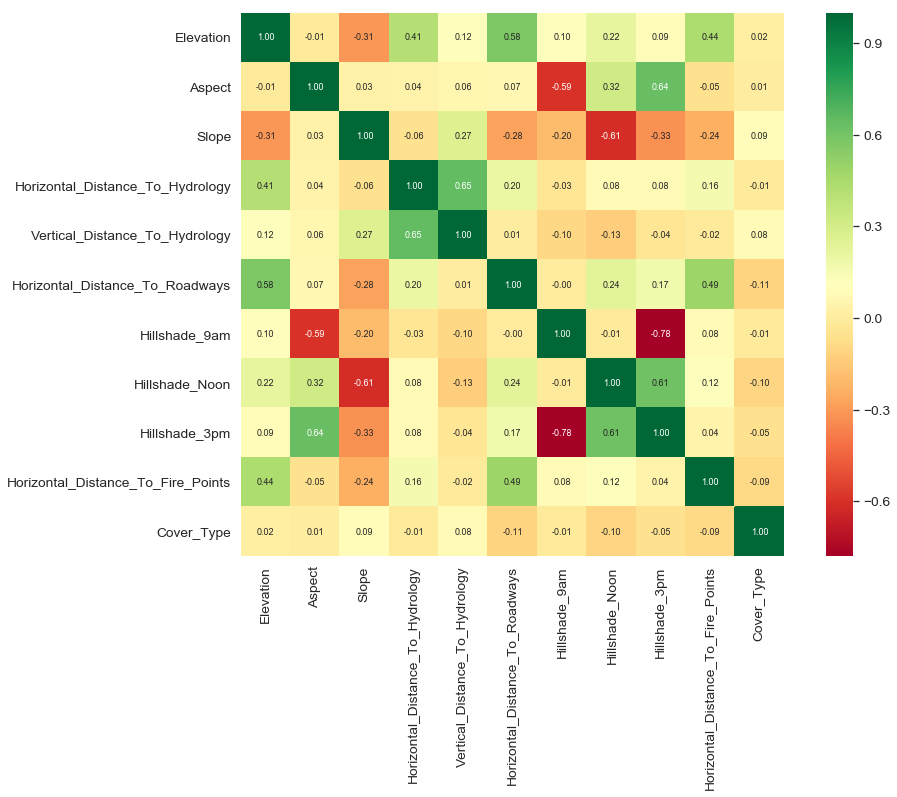

In [62]:
plt.figure(figsize=(15, 10))
sns.set(font_scale=1.25)
sns.heatmap(df_train[feat_num].corr(), square=True, cmap='RdYlGn',annot=True,annot_kws={'size': 9},fmt='.2f')

As one would expect, hillshades at three different times are moderately correlated with each other. 
Elevation is positively correlated with the three horizontal distances (hydrology, roadways, fire points), which makes intuitive sense.
Slope is negatively correlated with hillshade, specially at noon, thus implying more slope equals less sunlight.

# MODEL AND PREDICTION
We first establish a baseline using Random Forest, and then we will move on to more sophisticated ML models and feature selection strategies

In [47]:
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
# from sklearn.model_selection import GridSearchCV
# from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, roc_curve, make_scorer, f1_score

from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import StratifiedKFold

# Since the dataset is class-balanced, we can use macro averaging for the F1 scorer
scorer = make_scsorer(f1_score, greater_is_better=True, average = 'macro')

In [38]:
# Extract training data and labels
train_set = df_train.drop(columns = ['Cover_Type','Id'])
test_set = df_test.drop(columns = ['Id'])
test_ids = df_test['Id'].values
train_labels = np.asarray(df_train['Cover_Type'])
[num_examples,num_feat] = train_set.shape

# Submission base which is used for making submissions to the competition
submission_base = df_test[['Id']].copy()

In [53]:
# Using stratified kfold cross validation
nfolds = 10
strkfold = StratifiedKFold(n_splits = nfolds, shuffle = True)

In [74]:
# Create pipeline for scaling
features = train_set.columns.tolist()
pipeline = Pipeline([('scaler', MinMaxScaler())])
# pipeline = Pipeline([('scaler', StandardScaler())])

# Fit and transform training data
train_set = pipeline.fit_transform(train_set)
test_set = pipeline.transform(test_set)

/anaconda3/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning:

Data with input dtype uint8, int64 were all converted to float64 by MinMaxScaler.



In [49]:
# Routine to plot feature importances
def plot_feature_importances(df, n = 10, threshold = None):
    """Plots n most important features. Also plots the cumulative importance if
    threshold is specified and prints the number of features needed to reach threshold cumulative importance.
    Intended for use with any tree-based feature importances. 
    
    Args:
        df (dataframe): Dataframe of feature importances. Columns must be "feature" and "importance".
    
        n (int): Number of most important features to plot. Default is 10.
    
        threshold (float): Threshold for cumulative importance plot. If not provided, no plot is made. Default is None.
        
    Returns:
        df (dataframe): Dataframe ordered by feature importances with a normalized column (sums to 1) 
                        and a cumulative importance column
    
    Note:
    
        * Normalization in this case means sums to 1. 
        * Cumulative importance is calculated by summing features from most to least important
        * A threshold of x will show the most important features needed to reach 100*x% of cumulative importance
    
    """    
    # Sort features with most important at the head
    df = df.sort_values('importance', ascending = False).reset_index(drop = True)
    
    # Normalize the feature importances to add up to one and calculate cumulative importance
    df['importance_normalized'] = df['importance'] / df['importance'].sum()
    df['cumulative_importance'] = np.cumsum(df['importance_normalized'])
        
    # Bar plot of n most important features
    trace0 = go.Bar(
                    y=df.loc[:n,'feature'],
                    x=df.loc[:n,'importance_normalized'],
                    marker=dict(
                        color='rgba(50, 171, 96, 0.6)',
                        line=dict(
                            color='rgba(50, 171, 96, 1.0)',
                            width=1),
                    ), orientation = 'h')
    layout = go.Layout(title='Normalized importance of features',
                      yaxis = dict(autorange = "reversed",
                                  tickangle = 0,
                                  automargin=True),
                      width=800)

    fig = go.Figure(data=[trace0], layout=layout)
    plotly.offline.iplot(fig, filename='norm-importance')
    
    
    if threshold:
        # Number of features needed for threshold cumulative importance
        # This is the index (will need to add 1 for the actual number)
        importance_index = np.min(np.where(df['cumulative_importance'] > threshold))
        
                
        trace0 = go.Scatter(x=df.index,y=df['cumulative_importance'],line = dict(color = 'blue'))
        trace1 = go.Scatter(x=[importance_index + 1,importance_index + 1],y=[0,1.02],
                            line = dict(color = 'red',
                                       dash ='dash'))
        
        fig1 = go.Figure(data=[trace0,trace1])
        fig1['layout'].update(title='Cumulative Feature Importance',
                            xaxis = dict(title='Number of Features'),
                            yaxis = dict(title='Cumulative Importance'),
                             showlegend=False)
        plotly.offline.iplot(fig1, filename='basic-line')

        print(f'{importance_index + 1} features required for {100*threshold}% of cumulative importance.')
    
    return df

In [51]:
# Routine to train a model with cross-validation and append the results to a dataframe

model_results = pd.DataFrame(columns = ['model','cv_mean','cv_std'])

def run_cv_model(model, train_set, train_labels, name, model_results = None):
    
    cv_scores = cross_val_score(model, train_set, train_labels, cv=strkfold, scoring=scorer)
    
    print(f'{strkfold.n_splits}-Fold Cross Validation F1 Score = \
            {round(cv_scores.mean(), 4)} with std = {round(cv_scores.std(), 4)}')
    
    if model_results is not None:
        model_results = model_results.append(pd.DataFrame({'model':name,
                                                           'cv_mean':cv_scores.mean(),
                                                           'cv_std': cv_scores.std()}, index=[0]),
                                            ignore_index=True)
        return model_results
    
    

In [77]:
# Routine to plot scores of model_results

def plot_scores(model):
#     model.set_index('model', inplace=True)
    
    trace0 = go.Bar(
                    y=model['cv_mean'],
                    x=model['model'],
                    marker=dict(
                        color='orange',
                        line=dict(
                            color='black',
                            width=1),
                    ),
                    error_y=dict(
                            type='data',
                            array=model['cv_std'],
                            visible=True,
                            color ='black')
                    )
    
    layout = go.Layout(title='F1 scores of models',
                      width=800, xaxis = dict(tickfont=dict(size=14), automargin=True))

    fig = go.Figure(data=[trace0], layout=layout)
    plotly.offline.iplot(fig, filename='F1-scores')
    

In [78]:
strkfold.n_splits


10

## Random Forest baseline classifier
Use 10-fold cross validation to get prediction results

In [54]:
model_rf = RandomForestClassifier(n_estimators=100, random_state=10, n_jobs = -1)
# 10 fold cross validation
model_results = run_cv_model(model_rf, train_set, train_labels, 'RF', model_results)

10-Fold Cross Validation F1 Score =             0.8644 with std = 0.006


Examine feature importances using the whole training set to fit

In [55]:
model_rf.fit(train_set, train_labels)

# Feature importances into a dataframe
feature_importances = pd.DataFrame({'feature': features, 'importance': model_rf.feature_importances_})
feature_importances.head()


ValueError: arrays must all be same length

In [56]:
norm_fi = plot_feature_importances(feature_importances, threshold=0.95)

NameError: name 'feature_importances' is not defined

#### Use recursive feature elimination to improve RF

In [82]:
from sklearn.feature_selection import RFECV

# Create a model for feature selection
estimator = RandomForestClassifier(random_state = 10, n_estimators = 100,  n_jobs = -1)

# Create the object
selector = RFECV(estimator, step = 1, cv = strkfold, scoring= scorer, n_jobs = -1)

In [83]:
# Fit to training data
selector.fit(train_set, train_labels)

RFECV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
   estimator=RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=10, verbose=0, warm_start=False),
   min_features_to_select=1, n_jobs=-1,
   scoring=make_scorer(f1_score, average=macro), step=1, verbose=0)

In [84]:
features_selected = [feat for (i,feat) in enumerate(features) if selector.ranking_[i]==1]

In [85]:
# Plot results
trace0 = go.Scatter(x=np.asarray(range(1,1+num_feat)),y=selector.grid_scores_,line = dict(color = 'blue'))
trace1 = go.Scatter(x=[selector.n_features_,selector.n_features_],
                    y=[np.min(selector.grid_scores_),np.max(selector.grid_scores_)],
                            line = dict(color = 'red',
                                       dash ='dash'))
fig1 = go.Figure(data=[trace0,trace1])
fig1['layout'].update(title=f'Recursive feature elimination -- score improves up to {selector.n_features_} features',
                              xaxis = dict(title='Number of Features'),
                              yaxis = dict(title='Macro F1 score'),
                              showlegend=False)
plotly.offline.iplot(fig1, filename='basic-line')

In [86]:
# Retrain the model 
model_results = run_cv_model(model_rf,selector.transform(train_set),train_labels,'RF-RFE', model_results)

10-Fold Cross Validation F1 Score =             0.867 with std = 0.0089


## Compare multiple models
Run several models for classification (without fine tuning) to determine a good baseline model that works for this dataset

In [87]:
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegressionCV, RidgeClassifierCV
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier


In [88]:
# Run linear SVM
model_results = run_cv_model(LinearSVC(), train_set, train_labels, 'LSVC', model_results)

10-Fold Cross Validation F1 Score =             0.6662 with std = 0.0103


In [89]:
# Run  Gaussian Naive Bayes
model_results = run_cv_model(GaussianNB(), train_set, train_labels, 'GNB', model_results)

In [90]:
# Run  Multi-layer perceptron
model_results = run_cv_model(MLPClassifier(hidden_layer_sizes = (32, 64, 128, 64, 32), max_iter = 500),
                             train_set, train_labels, 'MLP-0', model_results)

10-Fold Cross Validation F1 Score =             0.8297 with std = 0.0146


In [91]:
# Run  LDA
model_results = run_cv_model(LinearDiscriminantAnalysis(), train_set, train_labels, 'LDA', model_results)
model_results = run_cv_model(LinearDiscriminantAnalysis(), selector.transform(train_set),
                             train_labels, 'LDA-RFE', model_results)

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_anal

10-Fold Cross Validation F1 Score =             0.6485 with std = 0.0093


/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.



10-Fold Cross Validation F1 Score =             0.648 with std = 0.0142


/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.



In [92]:
# Run  Logistic Regression
model_results = run_cv_model(LogisticRegressionCV(), train_set, train_labels, 'LR', model_results)

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.

/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning:

You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: Conver

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.

/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning:

You should specify a value for 'cv' instead of relying on th

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:460: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.

/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning:

You should specify a value for 'cv' instead of relying on th

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.

/anaconda3/lib/python3.6/site-packages/s

10-Fold Cross Validation F1 Score =             0.6725 with std = 0.0112


/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:758: ConvergenceWarning:

lbfgs failed to converge. Increase the number of iterations.



In [93]:
# Run  Ridge Regression
model_results = run_cv_model(RidgeClassifierCV(), train_set, train_labels, 'RR', model_results)

10-Fold Cross Validation F1 Score =             0.6281 with std = 0.0125


In [94]:
# Run  KNN
kn = [3, 5, 10, 20]
for n in kn:
    model_results = run_cv_model(KNeighborsClassifier(n_neighbors=n),
                                 train_set, train_labels, f'KNN-{n}', model_results)

10-Fold Cross Validation F1 Score =             0.8049 with std = 0.0105
10-Fold Cross Validation F1 Score =             0.7916 with std = 0.0074
10-Fold Cross Validation F1 Score =             0.7715 with std = 0.0101
10-Fold Cross Validation F1 Score =             0.7371 with std = 0.0083


In [95]:
plot_scores(model_results)

## Use gradient boosting

In [96]:
import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'
from xgboost import XGBClassifier

In [97]:
def macro_f1_score(labels, predictions):
    
    # Reshape the predictions as needed
    predictions = predictions.reshape(num_ct, -1 ).argmax(axis = 0)

    metric_value = f1_score(labels, predictions, average = 'macro')
    
    # Return is name, value, is_higher_better
    return 'macro_f1', metric_value, True

In [115]:
import lightgbm as lgb

def model_lgb(train_set, train_labels, feature_names, test_set, test_ids, 
              strkfold, return_preds = False, hyp = None):
    """Model using the GBM and cross validation.
       Trains with early stopping on each fold.
       Hyperparameters probably need to be tuned."""
    
    # Option for user specified hyperparameters
    if hyp is not None:
        # Using early stopping so do not need number of estimators
        if 'n_estimators' in hyp:
            del hyp['n_estimators']
        params = hyp
    
    else:
        # Model hyperparameters
        params = {'boosting_type': 'dart', 
                  'colsample_bytree': 0.88, 
                  'learning_rate': 0.028, 
                   'min_child_samples': 10, 
                   'num_leaves': 36, 'reg_alpha': 0.76, 
                   'reg_lambda': 0.43, 
                   'subsample_for_bin': 40000, 
                   'subsample': 0.54, 
                   'class_weight': 'balanced'}
    
    # Build the model
    model = lgb.LGBMClassifier(**params, objective = 'multiclass', 
                               n_jobs = -1, n_estimators = 10000,
                               random_state = 10)
    
    
    # Hold all the predictions from each fold
    predictions = pd.DataFrame()
    importances = np.zeros(len(feature_names))
    
    
    valid_scores = []
    
    # Iterate through the folds
    for i, (train_indices, valid_indices) in enumerate(strkfold.split(train_set, train_labels)):
        
        # Dataframe for fold predictions
        fold_predictions = pd.DataFrame()
        
        # Training and validation data
        X_train = train_set[train_indices.tolist(), :]
        X_valid = train_set[valid_indices.tolist(), :]
        y_train = train_labels[train_indices.tolist()]
        y_valid = train_labels[valid_indices.tolist()]
        
        print('--------------------------------------------------')
        print(np.shape(X_train))
        print('--------------------------------------------------')
        
    
        # Train with early stopping
        model.fit(X_train, y_train, early_stopping_rounds = 100, 
                  eval_metric = macro_f1_score,
                  eval_set = [(X_train, y_train), (X_valid, y_valid)],
                  eval_names = ['train', 'valid'],
                  verbose = 300)
        
        # Record the validation fold score
        valid_scores.append(model.best_score_['valid']['macro_f1'])
        
        # Make predictions from the fold as probabilities
        fold_probabilitites = model.predict_proba(test_set)
        
        # Record each prediction for each class as a separate column
        for j in range(len(covertypes)):
            fold_predictions[(j + 1)] = fold_probabilitites[:, j]
            
        # Add needed information for predictions 
        fold_predictions['Id'] = test_ids
        fold_predictions['fold'] = (i+1)
        
        # Add the predictions as new rows to the existing predictions
        predictions = predictions.append(fold_predictions)
        
        # Feature importances
        importances += model.feature_importances_ / nfolds   
        
        # Display fold information
        print(f'Fold {i + 1}, Validation Score: {round(valid_scores[i], 5)}, Estimators Trained: {model.best_iteration_}')
        print('---------------------------------------------------------------------------------------------------------')

    # Feature importances dataframe
    feature_importances = pd.DataFrame({'feature': feature_names,
                                        'importance': importances})
    
    valid_scores = np.array(valid_scores)
    print(f'{nfolds}-fold cross validation score: {round(valid_scores.mean(), 5)} with std: {round(valid_scores.std(), 5)}.')
    
    # If we want to examine predictionson test set don't average over folds
    if return_preds:
        predictions['Cover_Type'] = predictions[covertypes].idxmax(axis = 1)
        predictions['confidence'] = predictions[covertypes].max(axis = 1)
        return predictions, feature_importances, valid_scores
    
    # Average the predictions on test set over folds
    predictions = predictions.groupby('Id', as_index = False).mean()
    
    # Find the class and associated probability
    predictions['Cover_Type'] = predictions[covertypes].idxmax(axis = 1)
    predictions['confidence'] = predictions[covertypes].max(axis = 1)
    predictions = predictions.drop(columns = ['fold'])
    
    # Merge with the base to have one prediction for each individual
    submission = submission_base.merge(predictions[['Id', 'Cover_Type', 'confidence']], on = 'Id', how = 'left')
            
    # return the submission and feature importances along with validation scores
    return submission, feature_importances, valid_scores

In [99]:
def macro_f1_score_xgb(predictions, data):
    
    # Reshape the predictions as needed
    predictions = predictions.argmax(axis = 1)
    metric_value = f1_score(data.get_label(), predictions, average = 'macro')
    
    # Return is name, value, is_higher_better
    return 'macro_f1', metric_value

In [ ]:
import xgboost as xgb

def model_xgb(train_set, train_labels, feature_names, test_set, test_ids, 
              strkfold, return_preds = False, hyp = None):
    """Model using the XGboost and cross validation.
       Trains with early stopping on each fold.
       Hyperparameters probably need to be tuned."""
    
    # Option for user specified hyperparameters
    if hyp is not None:
        # Using early stopping so do not need number of estimators
        if 'n_estimators' in hyp:
            del hyp['n_estimators']
        params = hyp
    
    else:
        # Model hyperparameters
        params = {'booster' : 'dart',
                  'max_depth': 10,
                  'learning_rate': 0.028,
                  'colsample_bytree': 0.88,
                  'subsample': 0.8,
                  'gamma': 0.05,
                  'reg_lambda': 0.43,
                  'reg_alpha': 0.76,
                  'min_child_weight': 5,
                  'num_class' : 7
                }

    
    # Build the model
    model = xgb.XGBClassifier(**params, objective = 'multi:softmax', 
                               n_jobs = -1, n_estimators = 10000,
                               random_state = 10)
    
    # Using stratified kfold cross validation
    strkfold = StratifiedKFold(n_splits = nfolds, shuffle = True)
    
    # Hold all the predictions from each fold
    predictions = pd.DataFrame()
    importances = np.zeros(len(feature_names))
    
    
    valid_scores = []
    
    # Iterate through the folds
    for i, (train_indices, valid_indices) in enumerate(strkfold.split(train_set, train_labels)):
        
        # Dataframe for fold predictions
        fold_predictions = pd.DataFrame()
        
        # Training and validation data
#         xgtrain = xgb.DMatrix(X_train, y_train)
        
        X_train = train_set[train_indices.tolist(), :]
        X_valid = train_set[valid_indices.tolist(), :]
        y_train = train_labels[train_indices.tolist()]
        y_valid = train_labels[valid_indices.tolist()]
        
        # Train with early stopping
        model.fit(X_train, y_train, early_stopping_rounds = 100, 
                  eval_metric = macro_f1_score_xgb,
                  eval_set = [(X_train, y_train), (X_valid, y_valid)],
                  verbose = True)
        
        # Record the validation fold score
        valid_scores.append(model.best_score['valid']['macro_f1'])
    
        
        # Make predictions from the fold as probabilities
        fold_probabilitites = model.predict_proba(test_set)
        
        # Record each prediction for each class as a separate column
        for j in range(len(covertypes)):
            fold_predictions[(j + 1)] = fold_probabilitites[:, j]
            
        # Add needed information for predictions 
        fold_predictions['Id'] = test_ids
        fold_predictions['fold'] = (i+1)
        
        # Add the predictions as new rows to the existing predictions
        predictions = predictions.append(fold_predictions)
        
        # Feature importances
        importances += model.feature_importances_ / nfolds   
        
        # Display fold information
        print(f'Fold {i + 1}, Validation Score: {round(valid_scores[i], 5)}, Estimators Trained: {model.best_iteration_}')
        print('---------------------------------------------------------------------------------------------------------')

    # Feature importances dataframe
    feature_importances = pd.DataFrame({'feature': feature_names,
                                        'importance': importances})
    
    valid_scores = np.array(valid_scores)
    print(f'{nfolds}-fold cross validation score: {round(valid_scores.mean(), 5)} with std: {round(valid_scores.std(), 5)}.')
    
    # If we want to examine predictionson test set don't average over folds
    if return_preds:
        predictions['Cover_Type'] = predictions[covertypes].idxmax(axis = 1)
        predictions['confidence'] = predictions[covertypes].max(axis = 1)
        return predictions, feature_importances, valid_scores
    
    # Average the predictions on test set over folds
    predictions = predictions.groupby('Id', as_index = False).mean()
    
    # Find the class and associated probability
    predictions['Cover_Type'] = predictions[covertypes].idxmax(axis = 1)
    predictions['confidence'] = predictions[covertypes].max(axis = 1)
    predictions = predictions.drop(columns = ['fold'])
    
    # Merge with the base to have one prediction for each individual
    submission = submission_base.merge(predictions[['Id', 'Cover_Type', 'confidence']], on = 'Id', how = 'left')
            
    # return the submission and feature importances along with validation scores
    return submission, feature_importances, valid_scores

#### Light gradient boosting with all features


In [92]:
# lgb_pred_fold, lgb_fi, scores_lgb = model_lgb(train_set, train_labels, features, test_set, test_ids, strkfold
#                                               return_preds=True)

In [93]:
# _ = plot_feature_importances(lgb_fi, threshold=0.95)
# print(f"There are {lgb_fi[lgb_fi['importance'] == 0].shape[0]} features with no importance.")

We now plot the confidence level for each cover type on each fold

In [94]:
# plt.rcParams['font.size'] = 18

# # Kdeplot
# g = sns.FacetGrid(lgb_pred_fold, row = 'fold', hue = 'Cover_Type', height = 4, aspect = 3)
# g.map(sns.kdeplot, 'confidence');
# g.add_legend();

# plt.suptitle('Distribution of Confidence by Fold and Target', y = 1.05);

In [95]:
# # Average the predictions on test set over folds
# lgb_pred = lgb_pred_fold.groupby('Id', as_index = False).mean()
    
# # Find the class and associated probability
# lgb_pred['Cover_Type'] = lgb_pred[covertypes].idxmax(axis = 1)
# lgb_pred['confidence'] = lgb_pred[covertypes].max(axis = 1)
# lgb_pred = lgb_pred.drop(columns = ['fold'])


In [96]:
# trace = []
# group_labels = []

# for i in covertypes:
#     trace.append(go.Box(y = lgb_pred[lgb_pred['Cover_Type']==i]['confidence'], name = f'Cover type {int(i)}'))

# layout = go.Layout(showlegend=False, xaxis = dict(tickfont=dict(size=12)), title = f"Box plot of confidence")

# fig = go.Figure(data=trace, layout=layout)

# plotly.offline.iplot(fig, filename="boxplot-confidence")

In [97]:
# model_results = model_results.append(pd.DataFrame({'model': "LGB", 
#                                                    'cv_mean':  scores_lgb.mean(),
#                                                    'cv_std':  scores_lgb.std()},index=[0]),
#                                                 sort = True)

#### Light gradient boosting with selected features (RFE)


In [ ]:
lgbselected_pred_fold, lgbselected_fi, lgbselected_scores = model_lgb(selector.transform(train_set),
                                                                    train_labels, features_selected,
                                                                    selector.transform(test_set), test_ids,
                                                                    strkfold, return_preds = True)

There are 0 features with no importance.


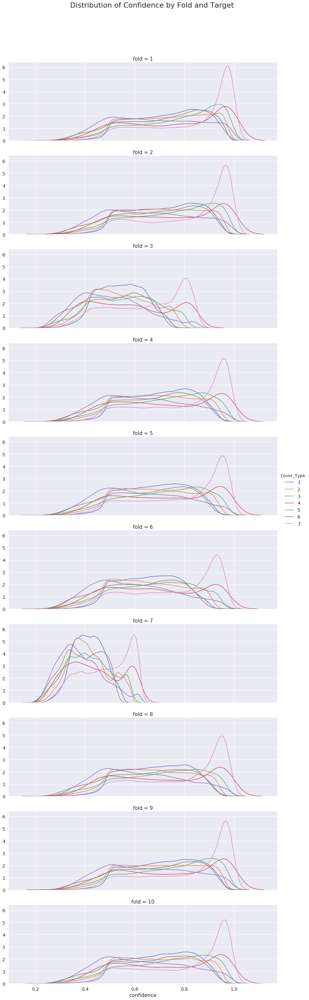

In [101]:
plt.rcParams['font.size'] = 18

# Kdeplot
g = sns.FacetGrid(lgbselected_pred_fold, row = 'fold', hue = 'Cover_Type', height = 4, aspect = 3)
g.map(sns.kdeplot, 'confidence');
g.add_legend();

plt.suptitle('Distribution of Confidence by Fold and Target', y = 1.05);

In [102]:
# Average the predictions on test set over folds
lgbselected_pred = lgbselected_pred_fold.groupby('Id', as_index = False).mean()
    
# Find the class and associated probability
lgbselected_pred['Cover_Type'] = lgbselected_pred[covertypes].idxmax(axis = 1)
lgbselected_pred['confidence'] = lgbselected_pred[covertypes].max(axis = 1)
lgbselected_pred = lgbselected_pred.drop(columns = ['fold'])


In [104]:
trace = []
group_labels = []

for i in covertypes:
    trace.append(go.Box(y = lgbselected_pred[lgbselected_pred['Cover_Type']==i]['confidence'],
                        name = f'Cover type {int(i)}'))

layout = go.Layout(showlegend=False, xaxis = dict(tickfont=dict(size=12)), title = f"Box plot of confidence")

fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig, filename="boxplot-confidence")

In [129]:
model_results = model_results.append(pd.DataFrame({'model': "LGB_RFE", 
                                                   'cv_mean':  lgbselected_scores.mean(),
                                                   'cv_std':  lgbselected_scores.std()}, index=[0]),
                                                sort = True)

NameError: name 'lgbselected_scores' is not defined

In [130]:
plot_scores(model_results)

0.8490661394394594

#### Xtreme gradient boosting with selected features (RFE)


In [133]:
# xgbselected_pred_fold, xgbselected_fi, xgbselected_scores = model_xgb(selector.transform(train_set),
#                                                                     train_labels,
#                                                                     features_selected,
#                                                                     selector.transform(test_set), test_ids,
#                                                                     strkfold)

[0]	validation_0-merror:0.230012	validation_1-merror:0.265212	validation_0-macro_f1:0.765711	validation_1-macro_f1:0.730049
Multiple eval metrics have been passed: 'validation_1-macro_f1' will be used for early stopping.

Will train until validation_1-macro_f1 hasn't improved in 100 rounds.
[1]	validation_0-merror:0.193048	validation_1-merror:0.232804	validation_0-macro_f1:0.802813	validation_1-macro_f1:0.761052
[2]	validation_0-merror:0.176881	validation_1-merror:0.218915	validation_0-macro_f1:0.819258	validation_1-macro_f1:0.776491
[3]	validation_0-merror:0.176073	validation_1-merror:0.214947	validation_0-macro_f1:0.819796	validation_1-macro_f1:0.780011
[4]	validation_0-merror:0.169533	validation_1-merror:0.206349	validation_0-macro_f1:0.826511	validation_1-macro_f1:0.788674
[5]	validation_0-merror:0.163286	validation_1-merror:0.200397	validation_0-macro_f1:0.832999	validation_1-macro_f1:0.794474
[6]	validation_0-merror:0.161302	validation_1-merror:0.19709	validation_0-macro_f1:0.834

[65]	validation_0-merror:0.120444	validation_1-merror:0.169974	validation_0-macro_f1:0.877147	validation_1-macro_f1:0.826716
[66]	validation_0-merror:0.119121	validation_1-merror:0.171296	validation_0-macro_f1:0.878521	validation_1-macro_f1:0.825395
[67]	validation_0-merror:0.119121	validation_1-merror:0.169974	validation_0-macro_f1:0.878517	validation_1-macro_f1:0.826754
[68]	validation_0-merror:0.118901	validation_1-merror:0.171958	validation_0-macro_f1:0.87874	validation_1-macro_f1:0.824649
[69]	validation_0-merror:0.118533	validation_1-merror:0.170635	validation_0-macro_f1:0.87912	validation_1-macro_f1:0.82604
[70]	validation_0-merror:0.118239	validation_1-merror:0.168651	validation_0-macro_f1:0.879443	validation_1-macro_f1:0.828059
[71]	validation_0-merror:0.117872	validation_1-merror:0.169974	validation_0-macro_f1:0.879801	validation_1-macro_f1:0.826771
[72]	validation_0-merror:0.117063	validation_1-merror:0.171296	validation_0-macro_f1:0.880626	validation_1-macro_f1:0.825437
[73

TypeError: 'float' object is not subscriptable

In [136]:
# params = {'booster' : 'dart',
#                   'max_depth': 10,
#                   'learning_rate': 0.028,
#                   'colsample_bytree': 0.88,
#                   'subsample': 0.8,
#                   'gamma': 0.05,
#                   'reg_lambda': 0.43,
#                   'reg_alpha': 0.76,
#                   'min_child_weight': 5,
#                   'num_class' : 7
#                 }
# # Build the model
# model = xgb.XGBClassifier(**params, objective = 'multi:softmax', 
#                                n_jobs = -1, n_estimators = 10000,
#                                random_state = 10)
    
#     # Using stratified kfold cross validation
# strkfold = StratifiedKFold(n_splits = nfolds, shuffle = True)
    
#     # Hold all the predictions from each fold
# predictions = pd.DataFrame()
# importances = np.zeros(len(features_selected))
    
    
# valid_scores = []
    
#     # Iterate through the folds
# for i, (train_indices, valid_indices) in enumerate(strkfold.split(train_set, train_labels)):
        
#         # Dataframe for fold predictions
#     fold_predictions = pd.DataFrame()
        
#         # Training and validation data
# #         xgtrain = xgb.DMatrix(X_train, y_train)
        
#     X_train = train_set[train_indices.tolist(), :]
#     X_valid = train_set[valid_indices.tolist(), :]
#     y_train = train_labels[train_indices.tolist()]
#     y_valid = train_labels[valid_indices.tolist()]
        
#         # Train with early stopping
#     model.fit(X_train, y_train, early_stopping_rounds = 100, 
#                   eval_metric = macro_f1_score_xgb,
#                   eval_set = [(X_train, y_train), (X_valid, y_valid)],
#                   verbose = True)
        

[0]	validation_0-merror:0.20216	validation_1-merror:0.251323	validation_0-macro_f1:0.794292	validation_1-macro_f1:0.743413
Multiple eval metrics have been passed: 'validation_1-macro_f1' will be used for early stopping.

Will train until validation_1-macro_f1 hasn't improved in 100 rounds.
[1]	validation_0-merror:0.188492	validation_1-merror:0.232143	validation_0-macro_f1:0.807104	validation_1-macro_f1:0.760857
[2]	validation_0-merror:0.181805	validation_1-merror:0.231481	validation_0-macro_f1:0.813299	validation_1-macro_f1:0.76066
[3]	validation_0-merror:0.172325	validation_1-merror:0.218254	validation_0-macro_f1:0.823693	validation_1-macro_f1:0.775417
[4]	validation_0-merror:0.168945	validation_1-merror:0.219577	validation_0-macro_f1:0.826969	validation_1-macro_f1:0.774355
[5]	validation_0-merror:0.168357	validation_1-merror:0.214286	validation_0-macro_f1:0.827515	validation_1-macro_f1:0.779677
[6]	validation_0-merror:0.166961	validation_1-merror:0.214286	validation_0-macro_f1:0.8287

[65]	validation_0-merror:0.119636	validation_1-merror:0.181217	validation_0-macro_f1:0.87789	validation_1-macro_f1:0.813956
[66]	validation_0-merror:0.119782	validation_1-merror:0.181217	validation_0-macro_f1:0.877716	validation_1-macro_f1:0.813831
[67]	validation_0-merror:0.11868	validation_1-merror:0.181878	validation_0-macro_f1:0.878871	validation_1-macro_f1:0.813159
[68]	validation_0-merror:0.118166	validation_1-merror:0.181878	validation_0-macro_f1:0.879425	validation_1-macro_f1:0.813147
[69]	validation_0-merror:0.117357	validation_1-merror:0.181217	validation_0-macro_f1:0.880246	validation_1-macro_f1:0.813945
[70]	validation_0-merror:0.116329	validation_1-merror:0.180556	validation_0-macro_f1:0.881304	validation_1-macro_f1:0.814631
[71]	validation_0-merror:0.116182	validation_1-merror:0.181217	validation_0-macro_f1:0.881461	validation_1-macro_f1:0.813945
[72]	validation_0-merror:0.115226	validation_1-merror:0.180556	validation_0-macro_f1:0.882487	validation_1-macro_f1:0.814625
[7

[28]	validation_0-merror:0.137934	validation_1-merror:0.19709	validation_0-macro_f1:0.859288	validation_1-macro_f1:0.798835
[29]	validation_0-merror:0.136464	validation_1-merror:0.195106	validation_0-macro_f1:0.860762	validation_1-macro_f1:0.800842
[30]	validation_0-merror:0.135141	validation_1-merror:0.195767	validation_0-macro_f1:0.862134	validation_1-macro_f1:0.800191
[31]	validation_0-merror:0.134847	validation_1-merror:0.193783	validation_0-macro_f1:0.862438	validation_1-macro_f1:0.802369
[32]	validation_0-merror:0.133965	validation_1-merror:0.196429	validation_0-macro_f1:0.863335	validation_1-macro_f1:0.799578
[33]	validation_0-merror:0.133598	validation_1-merror:0.193783	validation_0-macro_f1:0.863681	validation_1-macro_f1:0.802338
[34]	validation_0-merror:0.132643	validation_1-merror:0.193783	validation_0-macro_f1:0.864708	validation_1-macro_f1:0.802328
[35]	validation_0-merror:0.132422	validation_1-merror:0.19246	validation_0-macro_f1:0.864919	validation_1-macro_f1:0.803459
[3

[94]	validation_0-merror:0.105967	validation_1-merror:0.179894	validation_0-macro_f1:0.892034	validation_1-macro_f1:0.816619
[95]	validation_0-merror:0.105747	validation_1-merror:0.17791	validation_0-macro_f1:0.892301	validation_1-macro_f1:0.818729
[96]	validation_0-merror:0.105159	validation_1-merror:0.179233	validation_0-macro_f1:0.892896	validation_1-macro_f1:0.817354
[97]	validation_0-merror:0.104644	validation_1-merror:0.179894	validation_0-macro_f1:0.893451	validation_1-macro_f1:0.816685
[98]	validation_0-merror:0.104497	validation_1-merror:0.179894	validation_0-macro_f1:0.893589	validation_1-macro_f1:0.816685
[99]	validation_0-merror:0.10413	validation_1-merror:0.179233	validation_0-macro_f1:0.893976	validation_1-macro_f1:0.817395
[100]	validation_0-merror:0.103616	validation_1-merror:0.179233	validation_0-macro_f1:0.894495	validation_1-macro_f1:0.817395
Stopping. Best iteration:
[0]	validation_0-merror:0.203851	validation_1-merror:0.266534	validation_0-macro_f1:0.792885	validat

KeyboardInterrupt: 

In [139]:
model.best_score

0.730608

In [ ]:
# print(f"There are {xgb_fi_selected[xgb_fi_selected['importance'] == 0].shape[0]} features with no importance.")

In [ ]:
# trace = []
# group_labels = []

# for i in covertypes:
#     trace.append(go.Box(y = predictions_selected[predictions_selected['Cover_Type']==i]['confidence'], name = f'Cover type {int(i)}'))

# layout = go.Layout(showlegend=False, xaxis = dict(tickfont=dict(size=12)), title = f"Box plot of confidence")

# fig = go.Figure(data=trace, layout=layout)

# plotly.offline.iplot(fig, filename="boxplot-confidence")

In [ ]:
# model_results = model_results.append(pd.DataFrame({'model': "XGB_RFE", 
#                                                    'cv_mean':  valid_scores_selected.mean(),
#                                                    'cv_std':  valid_scores_selected.std()},index=[0]),
#                                                 sort = True)

In [ ]:
# plot_scores(model_results)

## Analysis of best model so far

In [107]:
model_rf.fit(selector.transform(train_set), train_labels)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=10, verbose=0, warm_start=False)

In [110]:
predictions = pd.DataFrame()
# Make predictions from the fold as probabilities
probabilities = model_rf.predict_proba(selector.transform(test_set))
        
# Record each prediction for each class as a separate column
for j in range(len(covertypes)):
    predictions[(j + 1)] = probabilities[:, j]
            
# Add needed information for predictions 
predictions['Id'] = test_ids

    
# Find the class and associated probability
predictions['Cover_Type'] = predictions[covertypes].idxmax(axis = 1)
predictions['confidence'] = predictions[covertypes].max(axis = 1)


In [112]:
predictions

,1,2,3,4,5,6,7,Id,Cover_Type,confidence
0,0.17,0.57,0.00,0.00,0.23,0.01,0.02,50084,2,0.57
1,0.13,0.48,0.02,0.00,0.34,0.03,0.00,220544,2,0.48
2,0.43,0.04,0.00,0.00,0.00,0.01,0.52,475787,7,0.52
3,0.00,0.00,0.84,0.01,0.00,0.15,0.00,288576,3,0.84
4,0.00,0.00,0.70,0.00,0.00,0.30,0.00,252981,3,0.70
5,0.10,0.27,0.02,0.00,0.50,0.10,0.01,253962,5,0.50
6,0.31,0.56,0.00,0.00,0.12,0.00,0.01,74680,2,0.56
7,0.36,0.57,0.01,0.00,0.00,0.00,0.06,391337,2,0.57
8,0.01,0.01,0.01,0.00,0.97,0.00,0.00,182525,5,0.97
9,0.16,0.83,0.00,0.00,0.01,0.00,0.00,139177,2,0.83


Investigate distribution of labels in train and test

In [113]:
trace0 = go.Bar(x = covertypes, y = df_train['Cover_Type'].value_counts()/num_train, name = 'train',
                marker=dict(
                        color='orange',
                        line=dict(
                            color='black',
                            width=1),
                    ))
trace1 = go.Bar(x = covertypes, y = predictions['Cover_Type'].value_counts()/num_test, name = 'predicted',
               marker=dict(
                        color='blue',
                        line=dict(
                            color='black',
                            width=1),
                    ))

    
layout = go.Layout(title='Label distribution in train and test (predicted)',
                      width=800, xaxis = dict(tickfont=dict(size=14), automargin=True),
                   yaxis = dict(title='Frequencies'))

fig = go.Figure(data=[trace0, trace1], layout=layout)
plotly.offline.iplot(fig, filename='label-dist')

In [114]:
submission = submission_base.merge(predictions[['Id', 'Cover_Type', 'confidence']], on = 'Id', how = 'left')

## Validation

In [82]:
from sklearn.metrics import confusion_matrix
import itertools

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Oranges):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    Source: http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    plt.figure(figsize = (10, 10))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, size = 24)
    plt.colorbar(aspect=4)
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45, size = 14)
    plt.yticks(tick_marks, classes, size = 14)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    
    # Labeling the plot
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), fontsize = 20,
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
        
    plt.grid(None)
    plt.tight_layout()
    plt.ylabel('True label', size = 18)
    plt.xlabel('Predicted label', size = 18)

In [83]:
from sklearn.model_selection import train_test_split

X_train, X_valid, y_train, y_valid = train_test_split(selector.transform(train_set),
                                                      train_labels,
                                                      test_size = 0.25,
                                                      random_state = 20)

from collections import Counter

print(list(Counter(y_valid).values()))

[527, 534, 552, 554, 548, 533, 532]


In [84]:

# params = {'boosting_type': 'dart', 
#                   'colsample_bytree': 0.88, 
#                   'learning_rate': 0.028, 
#                    'min_child_samples': 10, 
#                    'num_leaves': 36, 'reg_alpha': 0.76, 
#                    'reg_lambda': 0.43, 
#                    'subsample_for_bin': 40000, 
#                    'subsample': 0.54, 
#                    'class_weight': 'balanced'}
# model = lgb.LGBMClassifier(**params, n_estimators = 900, objective = 'multiclass', 
#                            random_state = 10)
# model.fit(X_train, y_train, verbose = 300);

model_rf.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=10, verbose=0, warm_start=False)

In [85]:
valid_preds = model_rf.predict_proba(X_valid)
preds_df = pd.DataFrame(valid_preds, columns = covertypes)

preds_df['prediction'] = preds_df[covertypes].idxmax(axis = 1)
preds_df['confidence'] = preds_df[covertypes].max(axis = 1)

In [86]:
print('F1 score:', round(f1_score(y_valid, preds_df['prediction'], average = 'macro'), 5))


F1 score: 0.85312


In [87]:
cm = confusion_matrix(y_valid, preds_df['prediction'])

Confusion matrix, without normalization


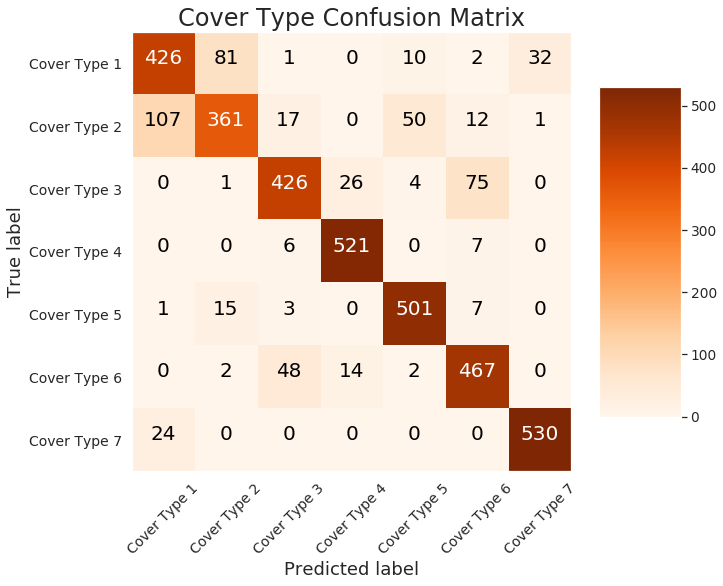

In [88]:
plot_confusion_matrix(cm, classes = [f"Cover Type {i}" for i in covertypes],
                      title = 'Cover Type Confusion Matrix')

Normalized confusion matrix


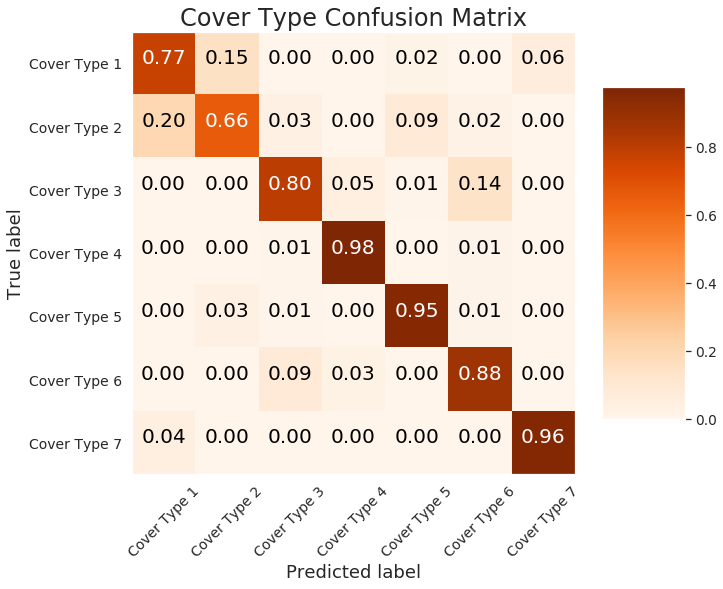

In [89]:
plot_confusion_matrix(cm, classes = [f"Cover Type {i}" for i in covertypes],
                      title = 'Cover Type Confusion Matrix', normalize=True)

In [90]:
cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
for i in range(len(nncovertypes)):
    for j in range(len(covertypes)):
        if cm_norm[i,j] > 0.1 and i!= j:
            print(f'Model predicts type {j+1} instead of type {i+1} on {cm[i,j]} ({cm_norm[i,j]:.2}%) examples')

Model predicts type 2 instead of type 1 on 81 (0.15%) examples
Model predicts type 1 instead of type 2 on 107 (0.2%) examples
Model predicts type 6 instead of type 3 on 75 (0.14%) examples


The greatest confusion is between 1&2, as well as between 3&6. It is reasonable, since the most important feature for the model is Elevation, and the PDFS of Elevation in the training set for 1&2 and for 3&6 are fairly similar. Analyze what happens when we train a RF without elevation

F1 score: 0.81087
Normalized confusion matrix


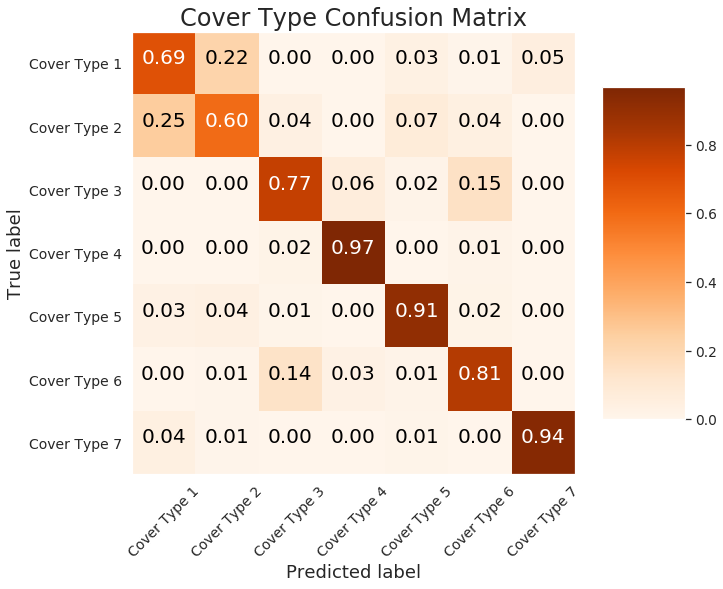

In [249]:
X_train0, X_valid0, y_train0, y_valid0 = \
train_test_split(pipeline.fit_transform(df_train.drop(columns = ['Cover_Type','Id','Elevation'])),
                 train_labels, test_size = 0.25, random_state = 20)
model_rf.fit(X_train0, y_train0)
valid_preds = model_rf.predict_proba(X_valid0)
preds_df = pd.DataFrame(valid_preds, columns = covertypes)

preds_df['prediction'] = preds_df[covertypes].idxmax(axis = 1)
preds_df['confidence'] = preds_df[covertypes].max(axis = 1)
cm = confusion_matrix(y_valid0, preds_df['prediction'])
print('F1 score:', round(f1_score(y_valid0, preds_df['prediction'], average = 'macro'), 5))

plot_confusion_matrix(cm, classes = [f"Cover Type {i}" for i in covertypes],
                      title = 'Cover Type Confusion Matrix', normalize=True)

Without Elevation we see a significant drop in F1 score (from 0.86 to 0.81)

## Feature engineering
Elevation is perhaps the most powerful feature in our model, but it show difficulties in separating classes 1-2 and classes 3-6. We now investigate how automated feature engineering can help in our problem

## Hyperopt

In [229]:
from hyperopt import hp, tpe, Trials, fmin, STATUS_OK
from hyperopt.pyll.stochastic import sample
import csv
import ast
from timeit import default_timer as timer

algo = tpe.suggest

In [230]:
1e-4

0.0001

### With random forest
#### Objective function

In [250]:
def objective(hyperparameters):
    """Return validation score from hyperparameters for RandomForest"""
    
    # Keep track of evals
    global ITERATION
    ITERATION += 1

    
    # Whether or not to use limit maximum depth
    if hyperparameters['max_depth'] is not None:
        hyperparameters['max_depth'] = int(hyperparameters['max_depth'])
    
    if hyperparameters['max_leaf_nodes'] is not None:
        hyperparameters['max_leaf_nodes'] = int(hyperparameters['max_leaf_nodes'])
        
    # Make sure parameters that need to be integers are integers
    for parameter_name in ['min_samples_split', 'min_samples_leaf','n_estimators']:
        hyperparameters[parameter_name] = int(hyperparameters[parameter_name])

    valid_scores = []
    best_estimators = []
    run_times = []
    
    start = timer()
    model = RandomForestClassifier(**hyperparameters, class_weight = 'balanced',
                               n_jobs=-1)
    
    cv_scores = cross_val_score(model, selector.transform(train_set), train_labels, cv=strkfold, scoring=scorer)
    
    end = timer()
    
    score = cv_scores.mean()
    score_std = cv_scores.std()
    loss = 1 - score
    
    run_time = end-start
    
    # Write to the csv file ('a' means append)
    of_connection = open(OUT_FILE, 'a')
    writer = csv.writer(of_connection)
    writer.writerow([loss, hyperparameters, ITERATION, run_time, score, score_std])
    of_connection.close()
    
    # Display progress
    if ITERATION % PROGRESS == 0:
        display(f'Iteration: {ITERATION}, Current Score: {round(score, 4)}.')
    
    return {'loss': loss, 'hyperparameters': hyperparameters, 'iteration': ITERATION,
            'time': run_time, 'status': STATUS_OK, 
            'score': score, 'score_std': score_std}

#### Search space

In [251]:
# Define the search space
space = {
    'max_features': hp.choice('max_features',['sqrt','log2',None, hp.uniform('max_features_frac', 0.1,0.8)]),
    'max_depth':  hp.choice('max_depth', [None, hp.quniform('max_depth_int', 20, 100, 1)]),
    'n_estimators': hp.quniform('n_estimators', 80, 300, 1),
    'min_samples_split': hp.quniform('min_samples_split', 1.5, 10.5, 1),
    'min_samples_leaf': hp.quniform('min_samples_leaf', 0.5, 10.5, 1),
    'min_weight_fraction_leaf': hp.choice('min_weight_fraction_leaf',
                                          [0, hp.loguniform('min_weight_fraction_leaf_frac', 
                                                            np.log(1e-8), np.log(1e-3))]),
    'criterion': hp.choice('criterion', ['gini','entropy']),
    'max_leaf_nodes': hp.choice('max_leaf_nodes',[None, hp.quniform('max_leaf_nodes_int', 5, 50, 1)]),
    'min_impurity_decrease': hp.choice('min_impurity_decrease',
                                       [0, hp.loguniform('min_impurity_decrease_frac', 
                                                            np.log(1e-10), np.log(1e-5))]),
    'bootstrap': hp.choice('bootstrap', [True, False])
    
}

#### Run and store results

In [252]:
trials = Trials()

# Create a file and open a connection
OUT_FILE = 'optimization_RF.csv'
of_connection = open(OUT_FILE, 'w')
writer = csv.writer(of_connection)

MAX_EVALS = 150
PROGRESS = 1
ITERATION = 0

# Write column names
headers = ['loss', 'hyperparameters', 'iteration', 'runtime', 'score', 'std']
writer.writerow(headers)
of_connection.close()

#### Search space

In [253]:
%%capture --no-display
display(f"Running Optimization for {MAX_EVALS} Trials.")

# Run optimization
best = fmin(fn = objective, space = space, algo = tpe.suggest, trials = trials,
            max_evals = MAX_EVALS)

'Running Optimization for 150 Trials.'

'Iteration: 1, Current Score: 0.6577.'

'Iteration: 2, Current Score: 0.6914.'

'Iteration: 3, Current Score: 0.836.'

'Iteration: 4, Current Score: 0.7069.'

'Iteration: 5, Current Score: 0.6571.'

'Iteration: 6, Current Score: 0.8473.'

'Iteration: 7, Current Score: 0.8087.'

'Iteration: 8, Current Score: 0.6144.'

'Iteration: 9, Current Score: 0.7784.'

'Iteration: 10, Current Score: 0.6961.'

'Iteration: 11, Current Score: 0.7738.'

'Iteration: 12, Current Score: 0.6031.'

'Iteration: 13, Current Score: 0.8228.'

'Iteration: 14, Current Score: 0.8697.'

'Iteration: 15, Current Score: 0.7117.'

'Iteration: 16, Current Score: 0.863.'

'Iteration: 17, Current Score: 0.6927.'

'Iteration: 18, Current Score: 0.845.'

'Iteration: 19, Current Score: 0.809.'

'Iteration: 20, Current Score: 0.72.'

'Iteration: 21, Current Score: 0.8725.'

'Iteration: 22, Current Score: 0.8706.'

'Iteration: 23, Current Score: 0.8618.'

'Iteration: 24, Current Score: 0.8722.'

'Iteration: 25, Current Score: 0.8627.'

'Iteration: 26, Current Score: 0.8715.'

'Iteration: 27, Current Score: 0.8556.'

'Iteration: 28, Current Score: 0.8661.'

'Iteration: 29, Current Score: 0.8546.'

'Iteration: 30, Current Score: 0.8607.'

'Iteration: 31, Current Score: 0.8735.'

'Iteration: 32, Current Score: 0.868.'

'Iteration: 33, Current Score: 0.8211.'

'Iteration: 34, Current Score: 0.8402.'

'Iteration: 35, Current Score: 0.8459.'

'Iteration: 36, Current Score: 0.7904.'

'Iteration: 37, Current Score: 0.8184.'

'Iteration: 38, Current Score: 0.6813.'

'Iteration: 39, Current Score: 0.7961.'

'Iteration: 40, Current Score: 0.7196.'

'Iteration: 41, Current Score: 0.8393.'

'Iteration: 42, Current Score: 0.8613.'

'Iteration: 43, Current Score: 0.6732.'

'Iteration: 44, Current Score: 0.8585.'

'Iteration: 45, Current Score: 0.8209.'

'Iteration: 46, Current Score: 0.645.'

'Iteration: 47, Current Score: 0.7869.'

'Iteration: 48, Current Score: 0.8361.'

'Iteration: 49, Current Score: 0.7238.'

'Iteration: 50, Current Score: 0.8483.'

'Iteration: 51, Current Score: 0.8496.'

'Iteration: 52, Current Score: 0.6753.'

'Iteration: 53, Current Score: 0.8487.'

'Iteration: 54, Current Score: 0.8745.'

'Iteration: 55, Current Score: 0.8524.'

'Iteration: 56, Current Score: 0.5986.'

'Iteration: 57, Current Score: 0.8503.'

'Iteration: 58, Current Score: 0.8437.'

'Iteration: 59, Current Score: 0.7759.'

'Iteration: 60, Current Score: 0.8657.'

'Iteration: 61, Current Score: 0.7132.'

'Iteration: 62, Current Score: 0.8443.'

'Iteration: 63, Current Score: 0.8468.'

'Iteration: 64, Current Score: 0.8269.'

'Iteration: 65, Current Score: 0.8579.'

'Iteration: 66, Current Score: 0.8688.'

'Iteration: 67, Current Score: 0.8725.'

'Iteration: 68, Current Score: 0.8716.'

'Iteration: 69, Current Score: 0.8749.'

'Iteration: 70, Current Score: 0.8679.'

'Iteration: 71, Current Score: 0.862.'

'Iteration: 72, Current Score: 0.8751.'

'Iteration: 73, Current Score: 0.8539.'

'Iteration: 74, Current Score: 0.8743.'

'Iteration: 75, Current Score: 0.8686.'

'Iteration: 76, Current Score: 0.7773.'

'Iteration: 77, Current Score: 0.8331.'

'Iteration: 78, Current Score: 0.6792.'

'Iteration: 79, Current Score: 0.874.'

'Iteration: 80, Current Score: 0.8708.'

'Iteration: 81, Current Score: 0.8717.'

'Iteration: 82, Current Score: 0.7913.'

'Iteration: 83, Current Score: 0.7135.'

'Iteration: 84, Current Score: 0.8678.'

'Iteration: 85, Current Score: 0.8539.'

'Iteration: 86, Current Score: 0.8595.'

'Iteration: 87, Current Score: 0.6504.'

'Iteration: 88, Current Score: 0.8578.'

'Iteration: 89, Current Score: 0.7878.'

'Iteration: 90, Current Score: 0.8566.'

'Iteration: 91, Current Score: 0.7113.'

'Iteration: 92, Current Score: 0.8188.'

'Iteration: 93, Current Score: 0.8554.'

'Iteration: 94, Current Score: 0.8727.'

'Iteration: 95, Current Score: 0.7843.'

'Iteration: 96, Current Score: 0.6763.'

'Iteration: 97, Current Score: 0.8741.'

'Iteration: 98, Current Score: 0.8424.'

'Iteration: 99, Current Score: 0.8672.'

'Iteration: 100, Current Score: 0.8617.'

'Iteration: 101, Current Score: 0.5835.'

'Iteration: 102, Current Score: 0.8589.'

'Iteration: 103, Current Score: 0.8006.'

'Iteration: 104, Current Score: 0.8759.'

'Iteration: 105, Current Score: 0.8585.'

'Iteration: 106, Current Score: 0.631.'

'Iteration: 107, Current Score: 0.8613.'

'Iteration: 108, Current Score: 0.8388.'

'Iteration: 109, Current Score: 0.8587.'

'Iteration: 110, Current Score: 0.7913.'

'Iteration: 111, Current Score: 0.8363.'

'Iteration: 112, Current Score: 0.6595.'

'Iteration: 113, Current Score: 0.8692.'

'Iteration: 114, Current Score: 0.8796.'

'Iteration: 115, Current Score: 0.8681.'

'Iteration: 116, Current Score: 0.849.'

'Iteration: 117, Current Score: 0.6857.'

'Iteration: 118, Current Score: 0.843.'

'Iteration: 119, Current Score: 0.8636.'

'Iteration: 120, Current Score: 0.8734.'

'Iteration: 121, Current Score: 0.8711.'

'Iteration: 122, Current Score: 0.7228.'

'Iteration: 123, Current Score: 0.8706.'

'Iteration: 124, Current Score: 0.8764.'

'Iteration: 125, Current Score: 0.8648.'

'Iteration: 126, Current Score: 0.8621.'

'Iteration: 127, Current Score: 0.8643.'

'Iteration: 128, Current Score: 0.6339.'

'Iteration: 129, Current Score: 0.8691.'

'Iteration: 130, Current Score: 0.8765.'

'Iteration: 131, Current Score: 0.8697.'

'Iteration: 132, Current Score: 0.8283.'

'Iteration: 133, Current Score: 0.6955.'

'Iteration: 134, Current Score: 0.8632.'

'Iteration: 135, Current Score: 0.8651.'

'Iteration: 136, Current Score: 0.8731.'

'Iteration: 137, Current Score: 0.8665.'

'Iteration: 138, Current Score: 0.6508.'

'Iteration: 139, Current Score: 0.8617.'

'Iteration: 140, Current Score: 0.8776.'

'Iteration: 141, Current Score: 0.8749.'

'Iteration: 142, Current Score: 0.8399.'

'Iteration: 143, Current Score: 0.7239.'

'Iteration: 144, Current Score: 0.8008.'

'Iteration: 145, Current Score: 0.8692.'

'Iteration: 146, Current Score: 0.872.'

'Iteration: 147, Current Score: 0.8788.'

'Iteration: 148, Current Score: 0.8773.'

'Iteration: 149, Current Score: 0.8765.'

'Iteration: 150, Current Score: 0.8697.'

#### Read hyperopt results and use best trial to evaluate validation set

In [254]:
results_hyp = pd.read_csv(OUT_FILE)
results_hyp_sort = results_hyp.sort_values('score',ascending=False).reset_index()

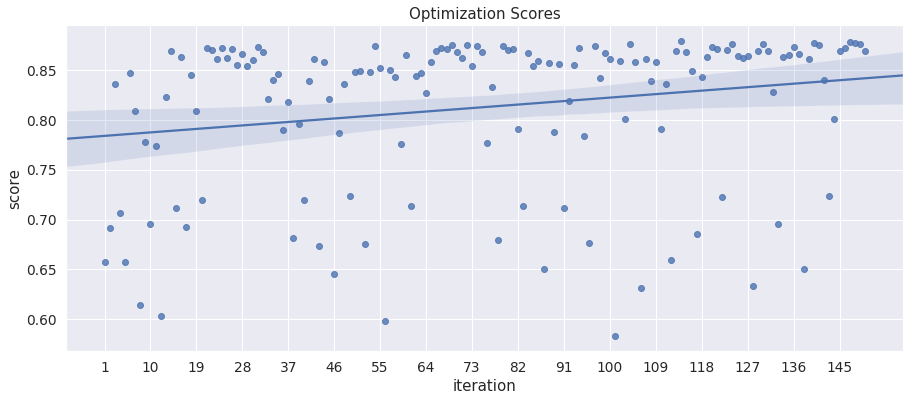

In [255]:
plt.figure(figsize = (15, 6))
sns.regplot('iteration', 'score', data = results_hyp);
plt.title("Optimization Scores");
plt.xticks(list(range(1, results_hyp['iteration'].max() + 1, 9)));

In [256]:
best_params = ast.literal_eval(results_hyp.loc[results_hyp['score'].idxmax(), 'hyperparameters'])

In [257]:
model_best = RandomForestClassifier(**best_params, class_weight = 'balanced',
                               n_jobs=-1)
model_best.fit(X_train, y_train)

RandomForestClassifier(bootstrap=False, class_weight='balanced',
            criterion='entropy', max_depth=None,
            max_features=0.18840718488914038, max_leaf_nodes=None,
            min_impurity_decrease=0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=1.180838667747332e-08,
            n_estimators=286, n_jobs=-1, oob_score=False,
            random_state=None, verbose=0, warm_start=False)

In [258]:
valid_preds = model_best.predict_proba(X_valid)
preds_df = pd.DataFrame(valid_preds, columns = covertypes)

preds_df['prediction'] = preds_df[covertypes].idxmax(axis = 1)
preds_df['confidence'] = preds_df[covertypes].max(axis = 1)

In [259]:
print('F1 score:', round(f1_score(y_valid, preds_df['prediction'], average = 'macro'), 5))


F1 score: 0.86811


In [260]:
cm = confusion_matrix(y_valid, preds_df['prediction'])

Normalized confusion matrix


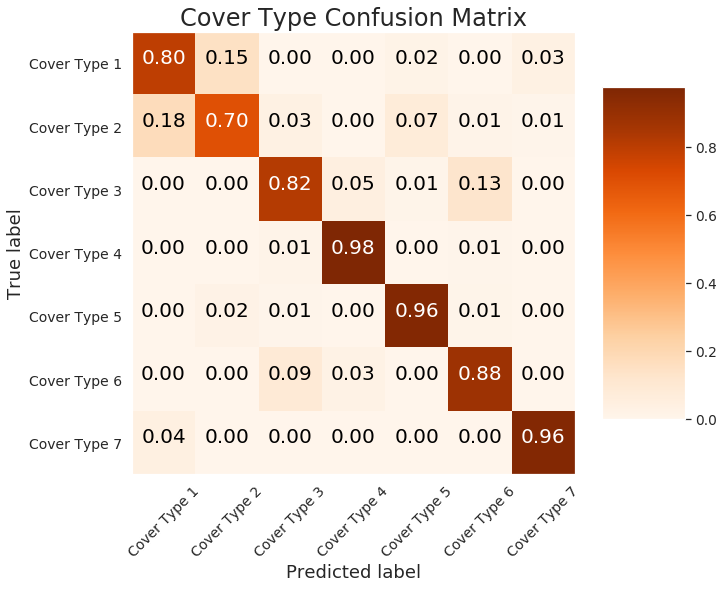

In [261]:
plot_confusion_matrix(cm, classes = [f"Cover Type {i}" for i in covertypes],
                      title = 'Cover Type Confusion Matrix', normalize=True)